In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

%matplotlib inline


bif_c = 0.2
num_iter_max=200000


# alpha=0.1
# alpha=0.2
alpha=0.3
# alpha=0.5


# alpha=0.8 # predict diverge
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'
figfilenamehead = "fig_policy_evaluation_"

loss_list = []
normalized_loss_list = []

In [2]:
import gym
import custom_gym
env = gym.make(env_name)

seed = 0
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)



c = 0.21455680991172585
2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_mdp_")


offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_mdp_


In [4]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "mdp_policy":agent.policy.my_np_select_action,
             "bamdp_policy":None,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_offlinedata()

load vi_base_ckpt


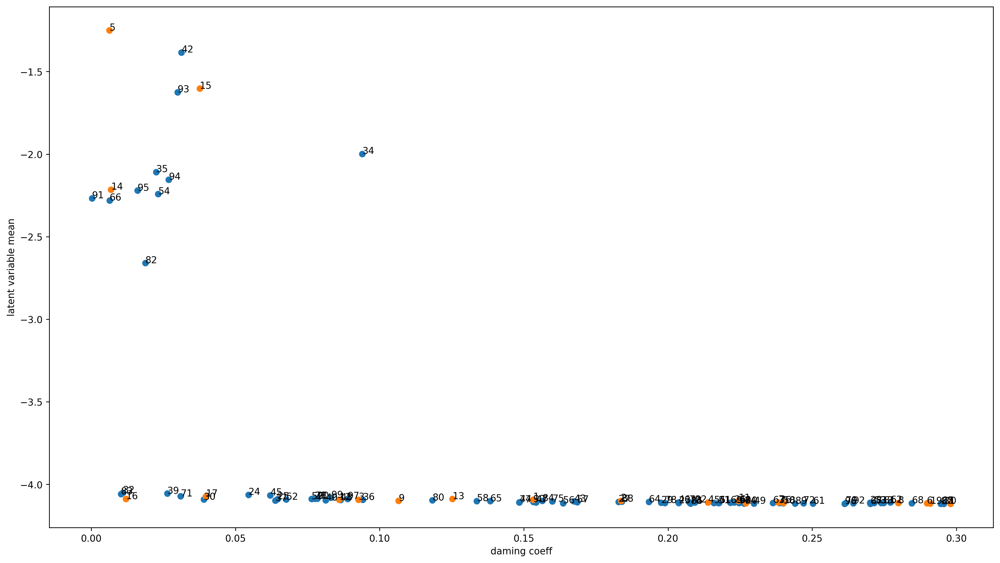

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_iter0.eps")
plt.savefig(figfilenamehead+"damping_latent_iter0.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_mdppolicy_data()

0  c = 0.16346495489906906
1  c = 0.175923049855898
2  c = 0.213101048692264


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ

3  c = 0.14501806056071762
4  c = 0.004052611988015664
5  c = 0.120134560420777
6  c = 0.25697024030079035
7  c = 0.09642657758269942
8  c = 0.05526129195564814
9  c = 0.11417486037608537
10  c = 0.25864988011260814
11  c = 0.020876132555705383
12  c = 0.2613891486606151
13  c = 0.10624180953664825
14  c = 0.03203027777652895
15  c = 0.1622476552961531
16  c = 0.1618277342655034
17  c = 0.055320312028603325
18  c = 0.09391364165595244
19  c = 0.11885913261799258
20  c = 0.11403897859981632
21  c = 0.09912067121474619
22  c = 0.06488189030041151
23  c = 0.03506631058301788
24  c = 0.19965083813641546
25  c = 0.08571604451747712
26  c = 0.1514796791677473
27  c = 0.04546713757372708
28  c = 0.13733918450179566
29  c = 0.1522597624567635
30  c = 0.02389789952996266
31  c = 0.0638122346167221
32  c = 0.28146488121321594
33  c = 0.2259386184773079
34  c = 0.28977259206899
35  c = 0.15402135084365112
36  c = 0.14479756250669107
37  c = 0.013467426965231165
38  c = 0.28867430773725383
39  c =

In [7]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  c = 0.20021770810986864
1  c = 0.1983582812192558
2  c = 0.022555950291700478
3  c = 0.20541677419620874
4  c = 0.10100278390403257
5  c = 0.18626578567738697
6  c = 0.05051976271514567
7  c = 0.047219332290270255
8  c = 0.1703964189334006
9  c = 0.14840815680292022
10  c = 0.24494872822400177
11  c = 0.025342155733352467
12  c = 0.29120495159551035
13  c = 0.1062823595846313
14  c = 0.2005682341251094
15  c = 0.2575002131665844
16  c = 0.2478069086585581
17  c = 0.10556652164894924
18  c = 0.1263102409001565
19  c = 0.06421935796424785
20  c = 0.162199131307732
21  c = 0.2946662208960819
22  c = 0.07020726813281049
23  c = 0.15752760672287627
24  c = 0.08439030047625135
25  c = 0.07330712053657978
26  c = 0.1016651025954488
27  c = 0.006908891882512702
28  c = 0.1901597193331265
29  c = 0.1863173542495256
30  c = 0.15759887301895484
31  c = 0.0308689768266279
32  c = 0.24135050248338633
33  c = 0.2181328493603175
34  c = 0.10463073088503207
35  c = 0.04975650100345974
36  c = 0.179

94  c = 0.1680459562217352
95  c = 0.1807952555827885
96  c = 0.1863211963979831
97  c = 0.12912084296439857
98  c = 0.1491634515077846
99  c = 0.20716237321689895
 
実環境方策rollout vs Sim環境方策rollout


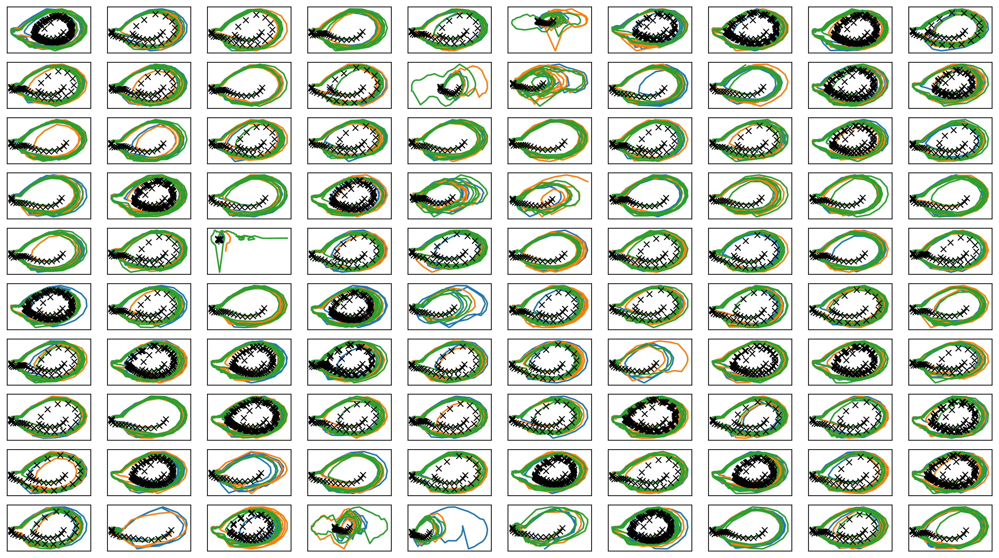

In [8]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter0.png")
plt.savefig(figfilenamehead+"joint_iter0.eps")
plt.savefig(figfilenamehead+"joint_iter0.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

In [9]:
print(datetime.datetime.now())

2023-03-29 22:04:39.338420


# Iter 1

In [10]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.27869592642983576
c = 0.03134266417929309
c = 0.18768298619818488
c = 0.22746078515527657
c = 0.008477972314120097
c = 0.0780614421036487
c = 0.009251997679063683
1  c = 0.03410023086744437
c = 0.2693986432667447
c = 0.23523766697946802
c = 0.08258328678149236
c = 0.05091028663638222
c = 0.2255817784776325
c = 0.08638976355194454
c = 0.28650721828062853
c = 0.16757616581017884
2  c = 0.2014415864427694
c = 0.11106717866097972
c = 0.29547195539844817
c = 0.05845866826088773
c = 0.015372332844441594
c = 0.1838751625674508
c = 0.10256014803462908
c = 0.2524100677524513
c = 0.025391797264514713
c = 0.12316007470867457
c = 0.22616336448267338
c = 0.24974797196600462
3  c = 0.10841560078414404
c = 0.06154806697686888
c = 0.06705307058899984
c = 0.15583859935522135
c = 0.17707470996570454
c = 0.16786738404595006
c = 0.2476335009210234
4  c = 0.0976423480347429
c = 0.18496903659890748
c = 0.013278861745546378
c = 0.10205618785916427
c = 0.014106873666669162
5  c = 0.19402567316037705


c = 0.17990015746807014
c = 0.24630547771384065
c = 0.0793861288033493
c = 0.28167872419885537
40  c = 0.2842304703941272
c = 0.2453951911476671
c = 0.10380060900923867
c = 0.2917185138651958
c = 0.16991292318500875
c = 0.02388665906696481
c = 0.05869218720214346
c = 0.10752058174220852
c = 0.23570631462068609
c = 0.16870487119724586
c = 0.09648756250162162
c = 0.2294975425219668
c = 0.18106195108554904
c = 0.059564674381799465
c = 0.029802557763132842
41  c = 0.11323842452961597
c = 0.20464121823317646
c = 0.18527363734244442
c = 0.07414279654095757
42  c = 0.22327186872150273
c = 0.1724861767812464
c = 0.21386781680195988
c = 0.09957466355477292
c = 0.03875150668764311
43  c = 0.05210994767636253
c = 0.04488878642492592
c = 0.23118406739021255
c = 0.17416945883004378
c = 0.13493956280716105
c = 0.030557005543765524
c = 0.04614585536580979
c = 0.038835781322623115
c = 0.06860161683877766
44  c = 0.2130412952329609
c = 0.11059937588203443
c = 0.06756157935815545
c = 0.11473980087381097

76  c = 0.21375367840521042
c = 0.18405974814048967
c = 0.10988467442475998
c = 0.18790349518310207
c = 0.08961451462666815
c = 0.2771888968951758
c = 0.2987503474678797
c = 0.03529722839723291
c = 0.2584529873719788
c = 0.0010379018920250616
c = 0.2805684681792523
c = 0.05237333121805956
c = 0.026822237455981533
77  c = 0.2388796244338437
c = 0.10626539922124115
c = 0.20555535694285587
c = 0.00840914382866954
c = 0.006229749680078322
c = 0.026163358819039185
c = 0.17932985562733983
c = 0.03667670675739197
c = 0.24513444614505234
c = 0.2357656808225332
c = 0.23095305291539642
c = 0.21483039836416198
78  c = 0.19536556427650756
c = 0.15837306569588475
c = 0.06678960150906656
c = 0.1043101331176575
c = 0.18149978032536104
c = 0.12911266702871554
c = 0.2522572516555469
c = 0.23274246198153117
c = 0.224512725676042
79  c = 0.10248410390108206
c = 0.043157607821014576
c = 0.11017995451684771
c = 0.13441280305292874
c = 0.018298703394113023
c = 0.21073818592933788
80  c = 0.2002782315134383


In [11]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.37738  validloss 1.46790±0.00000  bestvalidloss 1.46790  last_update 0
train: iter 1  trainloss 1.17147  validloss 1.29218±0.00000  bestvalidloss 1.29218  last_update 0
train: iter 2  trainloss 0.96669  validloss 1.06004±0.00000  bestvalidloss 1.06004  last_update 0
train: iter 3  trainloss 0.85670  validloss 0.91366±0.00000  bestvalidloss 0.91366  last_update 0
train: iter 4  trainloss 0.79389  validloss 0.83765±0.00000  bestvalidloss 0.83765  last_update 0
train: iter 5  trainloss 0.75190  validloss 0.78235±0.00000  bestvalidloss 0.78235  last_update 0
train: iter 6  trainloss 0.71678  validloss 0.73941±0.00000  bestvalidloss 0.73941  last_update 0
train: iter 7  trainloss 0.68455  validloss 0.69833±0.00000  bestvalidloss 0.69833  last_update 0
train: iter 8  trainloss 0.65374  validloss 0.66352±0.00000  bestvalidloss 0.66352  last_update 0
train: iter 9  trainloss 0.62246  validloss 0.62997±0.00000  bestvalidloss 0.62997  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.27809  validloss 0.30806±0.00000  bestvalidloss 0.30806  last_update 0
train: iter 85  trainloss 0.27601  validloss 0.30912±0.00000  bestvalidloss 0.30806  last_update 1
train: iter 86  trainloss 0.27429  validloss 0.30743±0.00000  bestvalidloss 0.30743  last_update 0
train: iter 87  trainloss 0.27407  validloss 0.30674±0.00000  bestvalidloss 0.30674  last_update 0
train: iter 88  trainloss 0.27275  validloss 0.30663±0.00000  bestvalidloss 0.30663  last_update 0
train: iter 89  trainloss 0.27475  validloss 0.30631±0.00000  bestvalidloss 0.30631  last_update 0
train: iter 90  trainloss 0.27342  validloss 0.31157±0.00000  bestvalidloss 0.30631  last_update 1
train: iter 91  trainloss 0.27173  validloss 0.30663±0.00000  bestvalidloss 0.30631  last_update 2
train: iter 92  trainloss 0.27178  validloss 0.30466±0.00000  bestvalidloss 0.30466  last_update 0
train: iter 93  trainloss 0.26936  validloss 0.30305±0.00000  bestvalidloss 0.30305  last_update 0
train: ite

train: iter 169  trainloss 0.24988  validloss 0.27907±0.00000  bestvalidloss 0.27896  last_update 3
train: iter 170  trainloss 0.24708  validloss 0.27987±0.00000  bestvalidloss 0.27896  last_update 4
train: iter 171  trainloss 0.24509  validloss 0.27969±0.00000  bestvalidloss 0.27896  last_update 5
train: iter 172  trainloss 0.24705  validloss 0.27870±0.00000  bestvalidloss 0.27870  last_update 0
train: iter 173  trainloss 0.24594  validloss 0.27827±0.00000  bestvalidloss 0.27827  last_update 0
train: iter 174  trainloss 0.24585  validloss 0.27779±0.00000  bestvalidloss 0.27779  last_update 0
train: iter 175  trainloss 0.24712  validloss 0.27944±0.00000  bestvalidloss 0.27779  last_update 1
train: iter 176  trainloss 0.24715  validloss 0.27717±0.00000  bestvalidloss 0.27717  last_update 0
train: iter 177  trainloss 0.24611  validloss 0.28180±0.00000  bestvalidloss 0.27717  last_update 1
train: iter 178  trainloss 0.24589  validloss 0.27642±0.00000  bestvalidloss 0.27642  last_update 0


train: iter 254  trainloss 0.23466  validloss 0.26621±0.00000  bestvalidloss 0.26621  last_update 0
train: iter 255  trainloss 0.23271  validloss 0.26956±0.00000  bestvalidloss 0.26621  last_update 1
train: iter 256  trainloss 0.23591  validloss 0.27625±0.00000  bestvalidloss 0.26621  last_update 2
train: iter 257  trainloss 0.23246  validloss 0.26533±0.00000  bestvalidloss 0.26533  last_update 0
train: iter 258  trainloss 0.23193  validloss 0.26702±0.00000  bestvalidloss 0.26533  last_update 1
train: iter 259  trainloss 0.23230  validloss 0.26529±0.00000  bestvalidloss 0.26529  last_update 0
train: iter 260  trainloss 0.23255  validloss 0.26679±0.00000  bestvalidloss 0.26529  last_update 1
train: iter 261  trainloss 0.23185  validloss 0.26543±0.00000  bestvalidloss 0.26529  last_update 2
train: iter 262  trainloss 0.23037  validloss 0.27059±0.00000  bestvalidloss 0.26529  last_update 3
train: iter 263  trainloss 0.23267  validloss 0.26534±0.00000  bestvalidloss 0.26529  last_update 4


train: iter 339  trainloss 0.22590  validloss 0.26037±0.00000  bestvalidloss 0.26037  last_update 0
train: iter 340  trainloss 0.22841  validloss 0.26180±0.00000  bestvalidloss 0.26037  last_update 1
train: iter 341  trainloss 0.22495  validloss 0.26173±0.00000  bestvalidloss 0.26037  last_update 2
train: iter 342  trainloss 0.22466  validloss 0.26202±0.00000  bestvalidloss 0.26037  last_update 3
train: iter 343  trainloss 0.22381  validloss 0.26185±0.00000  bestvalidloss 0.26037  last_update 4
train: iter 344  trainloss 0.22326  validloss 0.26610±0.00000  bestvalidloss 0.26037  last_update 5
train: iter 345  trainloss 0.22572  validloss 0.27244±0.00000  bestvalidloss 0.26037  last_update 6
train: iter 346  trainloss 0.22483  validloss 0.26420±0.00000  bestvalidloss 0.26037  last_update 7
train: iter 347  trainloss 0.22568  validloss 0.27628±0.00000  bestvalidloss 0.26037  last_update 8
train: iter 348  trainloss 0.22341  validloss 0.26091±0.00000  bestvalidloss 0.26037  last_update 9


train: iter 422  trainloss 0.22087  validloss 0.25823±0.00000  bestvalidloss 0.25809  last_update 24
train: iter 423  trainloss 0.21905  validloss 0.25996±0.00000  bestvalidloss 0.25809  last_update 25
train: iter 424  trainloss 0.21939  validloss 0.26194±0.00000  bestvalidloss 0.25809  last_update 26
train: iter 425  trainloss 0.21915  validloss 0.26167±0.00000  bestvalidloss 0.25809  last_update 27
train: iter 426  trainloss 0.21753  validloss 0.25823±0.00000  bestvalidloss 0.25809  last_update 28
train: iter 427  trainloss 0.22146  validloss 0.26127±0.00000  bestvalidloss 0.25809  last_update 29
train: iter 428  trainloss 0.21853  validloss 0.25821±0.00000  bestvalidloss 0.25809  last_update 30
train: iter 429  trainloss 0.21733  validloss 0.25956±0.00000  bestvalidloss 0.25809  last_update 31
train: iter 430  trainloss 0.21731  validloss 0.25805±0.00000  bestvalidloss 0.25805  last_update 0
train: iter 431  trainloss 0.22041  validloss 0.25810±0.00000  bestvalidloss 0.25805  last_u

train: iter 507  trainloss 0.21556  validloss 0.26133±0.00000  bestvalidloss 0.25633  last_update 49
train: iter 508  trainloss 0.21496  validloss 0.25830±0.00000  bestvalidloss 0.25633  last_update 50
train: iter 509  trainloss 0.21332  validloss 0.25930±0.00000  bestvalidloss 0.25633  last_update 51
train: iter 510  trainloss 0.21441  validloss 0.25959±0.00000  bestvalidloss 0.25633  last_update 52
train: iter 511  trainloss 0.21217  validloss 0.25829±0.00000  bestvalidloss 0.25633  last_update 53
train: iter 512  trainloss 0.21484  validloss 0.25972±0.00000  bestvalidloss 0.25633  last_update 54
train: iter 513  trainloss 0.21316  validloss 0.25740±0.00000  bestvalidloss 0.25633  last_update 55
train: iter 514  trainloss 0.21234  validloss 0.26029±0.00000  bestvalidloss 0.25633  last_update 56
train: iter 515  trainloss 0.21178  validloss 0.26046±0.00000  bestvalidloss 0.25633  last_update 57
train: iter 516  trainloss 0.21265  validloss 0.26160±0.00000  bestvalidloss 0.25633  last_

train: iter 591  trainloss 0.20595  validloss 0.25695±0.00000  bestvalidloss 0.25615  last_update 65
train: iter 592  trainloss 0.20808  validloss 0.25747±0.00000  bestvalidloss 0.25615  last_update 66
train: iter 593  trainloss 0.20836  validloss 0.25692±0.00000  bestvalidloss 0.25615  last_update 67
train: iter 594  trainloss 0.20839  validloss 0.25819±0.00000  bestvalidloss 0.25615  last_update 68
train: iter 595  trainloss 0.20815  validloss 0.25630±0.00000  bestvalidloss 0.25615  last_update 69
train: iter 596  trainloss 0.20874  validloss 0.25658±0.00000  bestvalidloss 0.25615  last_update 70
train: iter 597  trainloss 0.20871  validloss 0.25727±0.00000  bestvalidloss 0.25615  last_update 71
train: iter 598  trainloss 0.21053  validloss 0.25951±0.00000  bestvalidloss 0.25615  last_update 72
train: iter 599  trainloss 0.20715  validloss 0.25701±0.00000  bestvalidloss 0.25615  last_update 73
train: iter 600  trainloss 0.20933  validloss 0.25557±0.00000  bestvalidloss 0.25557  last_

train: iter 676  trainloss 0.20493  validloss 0.25517±0.00000  bestvalidloss 0.25355  last_update 2
train: iter 677  trainloss 0.20482  validloss 0.25811±0.00000  bestvalidloss 0.25355  last_update 3
train: iter 678  trainloss 0.20489  validloss 0.25599±0.00000  bestvalidloss 0.25355  last_update 4
train: iter 679  trainloss 0.20437  validloss 0.25541±0.00000  bestvalidloss 0.25355  last_update 5
train: iter 680  trainloss 0.20998  validloss 0.25528±0.00000  bestvalidloss 0.25355  last_update 6
train: iter 681  trainloss 0.20441  validloss 0.26162±0.00000  bestvalidloss 0.25355  last_update 7
train: iter 682  trainloss 0.20645  validloss 0.25582±0.00000  bestvalidloss 0.25355  last_update 8
train: iter 683  trainloss 0.20562  validloss 0.26277±0.00000  bestvalidloss 0.25355  last_update 9
train: iter 684  trainloss 0.20508  validloss 0.25591±0.00000  bestvalidloss 0.25355  last_update 10
train: iter 685  trainloss 0.20604  validloss 0.25652±0.00000  bestvalidloss 0.25355  last_update 1

train: iter 760  trainloss 0.20138  validloss 0.25234±0.00000  bestvalidloss 0.25234  last_update 0
train: iter 761  trainloss 0.20433  validloss 0.25409±0.00000  bestvalidloss 0.25234  last_update 1
train: iter 762  trainloss 0.20317  validloss 0.25452±0.00000  bestvalidloss 0.25234  last_update 2
train: iter 763  trainloss 0.20051  validloss 0.25400±0.00000  bestvalidloss 0.25234  last_update 3
train: iter 764  trainloss 0.20488  validloss 0.26395±0.00000  bestvalidloss 0.25234  last_update 4
train: iter 765  trainloss 0.20280  validloss 0.25687±0.00000  bestvalidloss 0.25234  last_update 5
train: iter 766  trainloss 0.20221  validloss 0.25786±0.00000  bestvalidloss 0.25234  last_update 6
train: iter 767  trainloss 0.20234  validloss 0.25456±0.00000  bestvalidloss 0.25234  last_update 7
train: iter 768  trainloss 0.20250  validloss 0.25951±0.00000  bestvalidloss 0.25234  last_update 8
train: iter 769  trainloss 0.20309  validloss 0.25237±0.00000  bestvalidloss 0.25234  last_update 9


train: iter 845  trainloss 0.20031  validloss 0.25034±0.00000  bestvalidloss 0.25034  last_update 0
train: iter 846  trainloss 0.20067  validloss 0.25408±0.00000  bestvalidloss 0.25034  last_update 1
train: iter 847  trainloss 0.20130  validloss 0.25952±0.00000  bestvalidloss 0.25034  last_update 2
train: iter 848  trainloss 0.20158  validloss 0.25591±0.00000  bestvalidloss 0.25034  last_update 3
train: iter 849  trainloss 0.20010  validloss 0.25300±0.00000  bestvalidloss 0.25034  last_update 4
train: iter 850  trainloss 0.20069  validloss 0.25235±0.00000  bestvalidloss 0.25034  last_update 5
train: iter 851  trainloss 0.20242  validloss 0.25793±0.00000  bestvalidloss 0.25034  last_update 6
train: iter 852  trainloss 0.19941  validloss 0.25336±0.00000  bestvalidloss 0.25034  last_update 7
train: iter 853  trainloss 0.20230  validloss 0.25171±0.00000  bestvalidloss 0.25034  last_update 8
train: iter 854  trainloss 0.20113  validloss 0.25189±0.00000  bestvalidloss 0.25034  last_update 9


train: iter 928  trainloss 0.19975  validloss 0.25589±0.00000  bestvalidloss 0.24998  last_update 1
train: iter 929  trainloss 0.19868  validloss 0.25128±0.00000  bestvalidloss 0.24998  last_update 2
train: iter 930  trainloss 0.19846  validloss 0.25296±0.00000  bestvalidloss 0.24998  last_update 3
train: iter 931  trainloss 0.19890  validloss 0.25098±0.00000  bestvalidloss 0.24998  last_update 4
train: iter 932  trainloss 0.19839  validloss 0.25420±0.00000  bestvalidloss 0.24998  last_update 5
train: iter 933  trainloss 0.20046  validloss 0.25354±0.00000  bestvalidloss 0.24998  last_update 6
train: iter 934  trainloss 0.20031  validloss 0.25410±0.00000  bestvalidloss 0.24998  last_update 7
train: iter 935  trainloss 0.19837  validloss 0.25221±0.00000  bestvalidloss 0.24998  last_update 8
train: iter 936  trainloss 0.19771  validloss 0.25172±0.00000  bestvalidloss 0.24998  last_update 9
train: iter 937  trainloss 0.19817  validloss 0.25121±0.00000  bestvalidloss 0.24998  last_update 10

train: iter 1012  trainloss 0.19907  validloss 0.25994±0.00000  bestvalidloss 0.24946  last_update 50
train: iter 1013  trainloss 0.19760  validloss 0.25204±0.00000  bestvalidloss 0.24946  last_update 51
train: iter 1014  trainloss 0.19666  validloss 0.25363±0.00000  bestvalidloss 0.24946  last_update 52
train: iter 1015  trainloss 0.19615  validloss 0.24963±0.00000  bestvalidloss 0.24946  last_update 53
train: iter 1016  trainloss 0.19617  validloss 0.25374±0.00000  bestvalidloss 0.24946  last_update 54
train: iter 1017  trainloss 0.19493  validloss 0.25373±0.00000  bestvalidloss 0.24946  last_update 55
train: iter 1018  trainloss 0.19713  validloss 0.26281±0.00000  bestvalidloss 0.24946  last_update 56
train: iter 1019  trainloss 0.19812  validloss 0.25490±0.00000  bestvalidloss 0.24946  last_update 57
train: iter 1020  trainloss 0.19563  validloss 0.25207±0.00000  bestvalidloss 0.24946  last_update 58
train: iter 1021  trainloss 0.19852  validloss 0.25298±0.00000  bestvalidloss 0.24

train: iter 1097  trainloss 0.19447  validloss 0.25558±0.00000  bestvalidloss 0.24740  last_update 47
train: iter 1098  trainloss 0.19600  validloss 0.26076±0.00000  bestvalidloss 0.24740  last_update 48
train: iter 1099  trainloss 0.19561  validloss 0.25114±0.00000  bestvalidloss 0.24740  last_update 49
train: iter 1100  trainloss 0.19461  validloss 0.25728±0.00000  bestvalidloss 0.24740  last_update 50
train: iter 1101  trainloss 0.19498  validloss 0.25685±0.00000  bestvalidloss 0.24740  last_update 51
train: iter 1102  trainloss 0.19415  validloss 0.25577±0.00000  bestvalidloss 0.24740  last_update 52
train: iter 1103  trainloss 0.19438  validloss 0.25531±0.00000  bestvalidloss 0.24740  last_update 53
train: iter 1104  trainloss 0.19395  validloss 0.25170±0.00000  bestvalidloss 0.24740  last_update 54
train: iter 1105  trainloss 0.19530  validloss 0.25558±0.00000  bestvalidloss 0.24740  last_update 55
train: iter 1106  trainloss 0.19389  validloss 0.25379±0.00000  bestvalidloss 0.24

In [12]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -167.2098543000221
valid_loss:  -204.67204662799833
train_loss:  -178.90832113087177
valid_loss:  -167.30185873031616


1e-08 1000.0


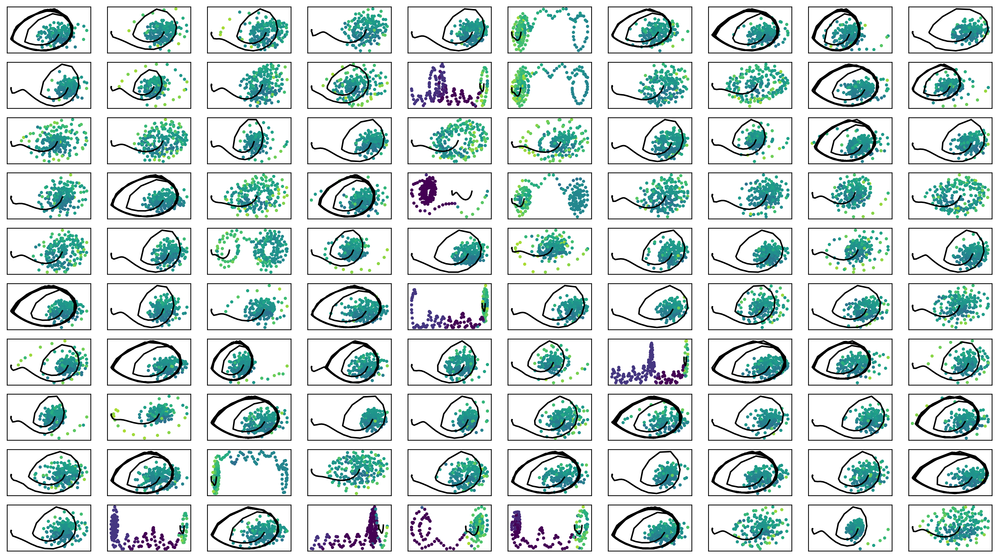

In [13]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [14]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [15]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [16]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

train_weighted_vae: enc_dec
train: iter 0  trainloss -169.37452  validloss -168.19000±0.00000  bestvalidloss -168.19000  last_update 0
train: iter 1  trainloss -165.16512  validloss -164.47103±0.00000  bestvalidloss -168.19000  last_update 1
train: iter 2  trainloss -178.33543  validloss -166.18245±0.00000  bestvalidloss -168.19000  last_update 2
train: iter 3  trainloss -178.19477  validloss -169.52556±0.00000  bestvalidloss -169.52556  last_update 0
train: iter 4  trainloss -178.17692  validloss -162.66070±0.00000  bestvalidloss -169.52556  last_update 1
train: iter 5  trainloss -177.18211  validloss -167.88680±0.00000  bestvalidloss -169.52556  last_update 2
train: iter 6  trainloss -181.70782  validloss -171.55674±0.00000  bestvalidloss -171.55674  last_update 0
train: iter 7  trainloss -182.93893  validloss -170.18709±0.00000  bestvalidloss -171.55674  last_update 1
train: iter 8  trainloss -183.46595  validloss -165.82228±0.00000  bestvalidloss -171.55674  last_update 2
train: it

train: iter 76  trainloss -198.27683  validloss -203.74913±0.00000  bestvalidloss -210.06248  last_update 5
train: iter 77  trainloss -199.86717  validloss -208.27336±0.00000  bestvalidloss -210.06248  last_update 6
train: iter 78  trainloss -198.45256  validloss -213.05901±0.00000  bestvalidloss -213.05901  last_update 0
train: iter 79  trainloss -196.75177  validloss -204.16568±0.00000  bestvalidloss -213.05901  last_update 1
train: iter 80  trainloss -199.45100  validloss -212.57698±0.00000  bestvalidloss -213.05901  last_update 2
train: iter 81  trainloss -200.06942  validloss -208.66422±0.00000  bestvalidloss -213.05901  last_update 3
train: iter 82  trainloss -195.28499  validloss -213.01175±0.00000  bestvalidloss -213.05901  last_update 4
train: iter 83  trainloss -197.42699  validloss -212.20702±0.00000  bestvalidloss -213.05901  last_update 5
train: iter 84  trainloss -199.23390  validloss -207.78491±0.00000  bestvalidloss -213.05901  last_update 6
train: iter 85  trainloss -1

train: iter 152  trainloss -232.45415  validloss -224.89942±0.00000  bestvalidloss -239.83191  last_update 2
train: iter 153  trainloss -234.64906  validloss -239.13290±0.00000  bestvalidloss -239.83191  last_update 3
train: iter 154  trainloss -231.69307  validloss -230.70826±0.00000  bestvalidloss -239.83191  last_update 4
train: iter 155  trainloss -233.29740  validloss -239.19305±0.00000  bestvalidloss -239.83191  last_update 5
train: iter 156  trainloss -229.60754  validloss -237.54124±0.00000  bestvalidloss -239.83191  last_update 6
train: iter 157  trainloss -235.27894  validloss -242.47889±0.00000  bestvalidloss -242.47889  last_update 0
train: iter 158  trainloss -234.39096  validloss -240.26694±0.00000  bestvalidloss -242.47889  last_update 1
train: iter 159  trainloss -235.34466  validloss -239.90938±0.00000  bestvalidloss -242.47889  last_update 2
train: iter 160  trainloss -237.13493  validloss -242.16234±0.00000  bestvalidloss -242.47889  last_update 3
train: iter 161  tr

train: iter 228  trainloss -263.92134  validloss -250.39456±0.00000  bestvalidloss -270.20031  last_update 5
train: iter 229  trainloss -264.76437  validloss -262.32906±0.00000  bestvalidloss -270.20031  last_update 6
train: iter 230  trainloss -264.02805  validloss -255.68272±0.00000  bestvalidloss -270.20031  last_update 7
train: iter 231  trainloss -265.91299  validloss -262.73812±0.00000  bestvalidloss -270.20031  last_update 8
train: iter 232  trainloss -266.93430  validloss -250.84719±0.00000  bestvalidloss -270.20031  last_update 9
train: iter 233  trainloss -265.59090  validloss -265.68961±0.00000  bestvalidloss -270.20031  last_update 10
train: iter 234  trainloss -265.17345  validloss -258.99008±0.00000  bestvalidloss -270.20031  last_update 11
train: iter 235  trainloss -266.13753  validloss -263.07045±0.00000  bestvalidloss -270.20031  last_update 12
train: iter 236  trainloss -270.40661  validloss -259.10275±0.00000  bestvalidloss -270.20031  last_update 13
train: iter 237

train: iter 304  trainloss -300.27576  validloss -277.79044±0.00000  bestvalidloss -308.91359  last_update 7
train: iter 305  trainloss -305.09942  validloss -306.31887±0.00000  bestvalidloss -308.91359  last_update 8
train: iter 306  trainloss -307.73743  validloss -290.33676±0.00000  bestvalidloss -308.91359  last_update 9
train: iter 307  trainloss -308.92929  validloss -295.24184±0.00000  bestvalidloss -308.91359  last_update 10
train: iter 308  trainloss -308.85347  validloss -304.45673±0.00000  bestvalidloss -308.91359  last_update 11
train: iter 309  trainloss -309.81887  validloss -292.41733±0.00000  bestvalidloss -308.91359  last_update 12
train: iter 310  trainloss -309.40692  validloss -289.88851±0.00000  bestvalidloss -308.91359  last_update 13
train: iter 311  trainloss -309.59788  validloss -301.10819±0.00000  bestvalidloss -308.91359  last_update 14
train: iter 312  trainloss -308.04492  validloss -301.53374±0.00000  bestvalidloss -308.91359  last_update 15
train: iter 3

train: iter 379  trainloss -348.00649  validloss -319.33938±0.00000  bestvalidloss -346.47228  last_update 5
train: iter 380  trainloss -344.78496  validloss -341.58260±0.00000  bestvalidloss -346.47228  last_update 6
train: iter 381  trainloss -346.49371  validloss -338.95747±0.00000  bestvalidloss -346.47228  last_update 7
train: iter 382  trainloss -344.07685  validloss -343.19254±0.00000  bestvalidloss -346.47228  last_update 8
train: iter 383  trainloss -347.45894  validloss -351.97418±0.00000  bestvalidloss -351.97418  last_update 0
train: iter 384  trainloss -347.30324  validloss -337.35675±0.00000  bestvalidloss -351.97418  last_update 1
train: iter 385  trainloss -345.26529  validloss -340.53136±0.00000  bestvalidloss -351.97418  last_update 2
train: iter 386  trainloss -341.49135  validloss -305.93605±0.00000  bestvalidloss -351.97418  last_update 3
train: iter 387  trainloss -348.13788  validloss -334.42083±0.00000  bestvalidloss -351.97418  last_update 4
train: iter 388  tr

train: iter 455  trainloss -377.70873  validloss -356.90815±0.00000  bestvalidloss -379.95468  last_update 13
train: iter 456  trainloss -376.72745  validloss -376.56655±0.00000  bestvalidloss -379.95468  last_update 14
train: iter 457  trainloss -380.41750  validloss -382.05760±0.00000  bestvalidloss -382.05760  last_update 0
train: iter 458  trainloss -381.17083  validloss -374.02527±0.00000  bestvalidloss -382.05760  last_update 1
train: iter 459  trainloss -379.87926  validloss -382.98293±0.00000  bestvalidloss -382.98293  last_update 0
train: iter 460  trainloss -385.94716  validloss -377.61243±0.00000  bestvalidloss -382.98293  last_update 1
train: iter 461  trainloss -382.97064  validloss -373.39043±0.00000  bestvalidloss -382.98293  last_update 2
train: iter 462  trainloss -381.51170  validloss -371.85996±0.00000  bestvalidloss -382.98293  last_update 3
train: iter 463  trainloss -386.43778  validloss -379.99127±0.00000  bestvalidloss -382.98293  last_update 4
train: iter 464  

train: iter 532  trainloss -407.52896  validloss -389.59904±0.00000  bestvalidloss -416.29867  last_update 11
train: iter 533  trainloss -411.73503  validloss -418.32153±0.00000  bestvalidloss -418.32153  last_update 0
train: iter 534  trainloss -398.64833  validloss -406.39882±0.00000  bestvalidloss -418.32153  last_update 1
train: iter 535  trainloss -411.14683  validloss -422.92033±0.00000  bestvalidloss -422.92033  last_update 0
train: iter 536  trainloss -409.10779  validloss -388.88260±0.00000  bestvalidloss -422.92033  last_update 1
train: iter 537  trainloss -404.43068  validloss -417.71332±0.00000  bestvalidloss -422.92033  last_update 2
train: iter 538  trainloss -412.16906  validloss -398.10754±0.00000  bestvalidloss -422.92033  last_update 3
train: iter 539  trainloss -408.32616  validloss -402.47037±0.00000  bestvalidloss -422.92033  last_update 4
train: iter 540  trainloss -405.34688  validloss -401.94249±0.00000  bestvalidloss -422.92033  last_update 5
train: iter 541  t

train: iter 608  trainloss -435.07879  validloss -414.03353±0.00000  bestvalidloss -437.48497  last_update 9
train: iter 609  trainloss -439.39564  validloss -398.33997±0.00000  bestvalidloss -437.48497  last_update 10
train: iter 610  trainloss -442.34910  validloss -407.58486±0.00000  bestvalidloss -437.48497  last_update 11
train: iter 611  trainloss -435.09877  validloss -414.63553±0.00000  bestvalidloss -437.48497  last_update 12
train: iter 612  trainloss -416.62149  validloss -383.94680±0.00000  bestvalidloss -437.48497  last_update 13
train: iter 613  trainloss -445.25885  validloss -382.16766±0.00000  bestvalidloss -437.48497  last_update 14
train: iter 614  trainloss -437.91597  validloss -435.16980±0.00000  bestvalidloss -437.48497  last_update 15
train: iter 615  trainloss -435.65697  validloss -441.80685±0.00000  bestvalidloss -441.80685  last_update 0
train: iter 616  trainloss -434.93378  validloss -443.98225±0.00000  bestvalidloss -443.98225  last_update 0
train: iter 6

train: iter 684  trainloss -453.99268  validloss -451.92200±0.00000  bestvalidloss -454.77399  last_update 1
train: iter 685  trainloss -452.50923  validloss -456.58840±0.00000  bestvalidloss -456.58840  last_update 0
train: iter 686  trainloss -459.57644  validloss -454.44136±0.00000  bestvalidloss -456.58840  last_update 1
train: iter 687  trainloss -455.39971  validloss -408.88752±0.00000  bestvalidloss -456.58840  last_update 2
train: iter 688  trainloss -442.50799  validloss -449.10906±0.00000  bestvalidloss -456.58840  last_update 3
train: iter 689  trainloss -446.41450  validloss -294.82994±0.00000  bestvalidloss -456.58840  last_update 4
train: iter 690  trainloss -454.93210  validloss -461.24275±0.00000  bestvalidloss -461.24275  last_update 0
train: iter 691  trainloss -457.39858  validloss -440.39419±0.00000  bestvalidloss -461.24275  last_update 1
train: iter 692  trainloss -459.97265  validloss -411.57214±0.00000  bestvalidloss -461.24275  last_update 2
train: iter 693  tr

train: iter 759  trainloss -481.87023  validloss -465.66825±0.00000  bestvalidloss -475.74204  last_update 3
train: iter 760  trainloss -478.52220  validloss -445.65616±0.00000  bestvalidloss -475.74204  last_update 4
train: iter 761  trainloss -473.83417  validloss -443.53917±0.00000  bestvalidloss -475.74204  last_update 5
train: iter 762  trainloss -470.42735  validloss -443.35058±0.00000  bestvalidloss -475.74204  last_update 6
train: iter 763  trainloss -478.61512  validloss -391.19337±0.00000  bestvalidloss -475.74204  last_update 7
train: iter 764  trainloss -473.53962  validloss -441.80494±0.00000  bestvalidloss -475.74204  last_update 8
train: iter 765  trainloss -470.96366  validloss -465.71664±0.00000  bestvalidloss -475.74204  last_update 9
train: iter 766  trainloss -465.39243  validloss -474.68487±0.00000  bestvalidloss -475.74204  last_update 10
train: iter 767  trainloss -475.05949  validloss -459.80937±0.00000  bestvalidloss -475.74204  last_update 11
train: iter 768  

train: iter 834  trainloss -483.22313  validloss -450.25886±0.00000  bestvalidloss -487.86056  last_update 15
train: iter 835  trainloss -502.19346  validloss -466.81796±0.00000  bestvalidloss -487.86056  last_update 16
train: iter 836  trainloss -490.77078  validloss -401.48452±0.00000  bestvalidloss -487.86056  last_update 17
train: iter 837  trainloss -491.96401  validloss -497.50730±0.00000  bestvalidloss -497.50730  last_update 0
train: iter 838  trainloss -497.88732  validloss -456.71178±0.00000  bestvalidloss -497.50730  last_update 1
train: iter 839  trainloss -488.49730  validloss -464.64712±0.00000  bestvalidloss -497.50730  last_update 2
train: iter 840  trainloss -496.80823  validloss -361.49609±0.00000  bestvalidloss -497.50730  last_update 3
train: iter 841  trainloss -500.58454  validloss -383.94218±0.00000  bestvalidloss -497.50730  last_update 4
train: iter 842  trainloss -500.52322  validloss -448.75049±0.00000  bestvalidloss -497.50730  last_update 5
train: iter 843 

train: iter 909  trainloss -515.98219  validloss -474.21895±0.00000  bestvalidloss -500.46191  last_update 16
train: iter 910  trainloss -512.06621  validloss -467.34522±0.00000  bestvalidloss -500.46191  last_update 17
train: iter 911  trainloss -511.19024  validloss -418.94497±0.00000  bestvalidloss -500.46191  last_update 18
train: iter 912  trainloss -518.33192  validloss -422.06091±0.00000  bestvalidloss -500.46191  last_update 19
train: iter 913  trainloss -515.80690  validloss -360.85103±0.00000  bestvalidloss -500.46191  last_update 20
train: iter 914  trainloss -512.77846  validloss -437.21190±0.00000  bestvalidloss -500.46191  last_update 21
train: iter 915  trainloss -511.49797  validloss -421.27286±0.00000  bestvalidloss -500.46191  last_update 22
train: iter 916  trainloss -512.62784  validloss -427.03053±0.00000  bestvalidloss -500.46191  last_update 23
train: iter 917  trainloss -510.42418  validloss -500.46458±0.00000  bestvalidloss -500.46458  last_update 0
train: iter

train: iter 985  trainloss -529.82854  validloss -508.65422±0.00000  bestvalidloss -522.10555  last_update 34
train: iter 986  trainloss -529.13914  validloss -443.75556±0.00000  bestvalidloss -522.10555  last_update 35
train: iter 987  trainloss -524.70444  validloss -505.41652±0.00000  bestvalidloss -522.10555  last_update 36
train: iter 988  trainloss -528.65867  validloss -539.39611±0.00000  bestvalidloss -539.39611  last_update 0
train: iter 989  trainloss -532.54823  validloss -523.30070±0.00000  bestvalidloss -539.39611  last_update 1
train: iter 990  trainloss -545.84205  validloss -469.25818±0.00000  bestvalidloss -539.39611  last_update 2
train: iter 991  trainloss -522.66452  validloss -489.38806±0.00000  bestvalidloss -539.39611  last_update 3
train: iter 992  trainloss -534.07241  validloss -469.66054±0.00000  bestvalidloss -539.39611  last_update 4
train: iter 993  trainloss -536.38621  validloss -482.66526±0.00000  bestvalidloss -539.39611  last_update 5
train: iter 994 

train: iter 1061  trainloss -548.29404  validloss -495.79825±0.00000  bestvalidloss -539.39611  last_update 73
train: iter 1062  trainloss -557.29105  validloss -459.00755±0.00000  bestvalidloss -539.39611  last_update 74
train: iter 1063  trainloss -556.90794  validloss -450.68243±0.00000  bestvalidloss -539.39611  last_update 75
train: iter 1064  trainloss -559.72243  validloss -497.99105±0.00000  bestvalidloss -539.39611  last_update 76
train: iter 1065  trainloss -558.33821  validloss -488.60313±0.00000  bestvalidloss -539.39611  last_update 77
train: iter 1066  trainloss -559.65391  validloss -475.49892±0.00000  bestvalidloss -539.39611  last_update 78
train: iter 1067  trainloss -557.51429  validloss -476.24464±0.00000  bestvalidloss -539.39611  last_update 79
train: iter 1068  trainloss -547.26396  validloss -416.54104±0.00000  bestvalidloss -539.39611  last_update 80
train: iter 1069  trainloss -536.91380  validloss -287.63246±0.00000  bestvalidloss -539.39611  last_update 81
t

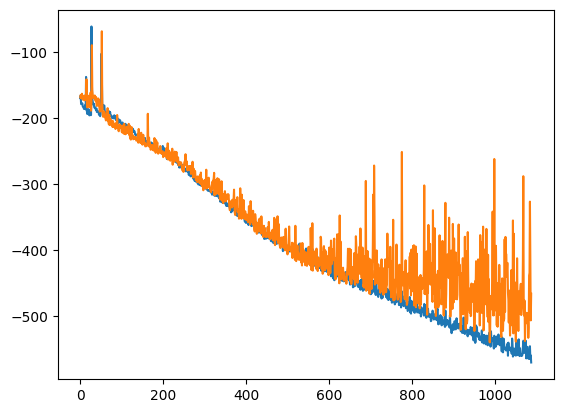

train_weighted_vae: enc
train: iter 0  trainloss -555.98175  validloss -484.90048±0.00000  bestvalidloss -484.90048  last_update 0
train: iter 1  trainloss -567.56320  validloss -480.93657±0.00000  bestvalidloss -484.90048  last_update 1
train: iter 2  trainloss -569.48140  validloss -440.73276±0.00000  bestvalidloss -484.90048  last_update 2
train: iter 3  trainloss -565.36408  validloss -522.28939±0.00000  bestvalidloss -522.28939  last_update 0
train: iter 4  trainloss -563.80524  validloss -424.53553±0.00000  bestvalidloss -522.28939  last_update 1
train: iter 5  trainloss -570.97166  validloss -475.76340±0.00000  bestvalidloss -522.28939  last_update 2
train: iter 6  trainloss -575.50344  validloss -508.96482±0.00000  bestvalidloss -522.28939  last_update 3
train: iter 7  trainloss -557.47639  validloss -482.63787±0.00000  bestvalidloss -522.28939  last_update 4
train: iter 8  trainloss -570.88625  validloss -492.67678±0.00000  bestvalidloss -522.28939  last_update 5
train: iter 9

train: iter 77  trainloss -571.49168  validloss -310.76881±0.00000  bestvalidloss -534.05720  last_update 67
train: iter 78  trainloss -569.82407  validloss -477.13891±0.00000  bestvalidloss -534.05720  last_update 68
train: iter 79  trainloss -575.73563  validloss -493.04868±0.00000  bestvalidloss -534.05720  last_update 69
train: iter 80  trainloss -570.62281  validloss -489.29969±0.00000  bestvalidloss -534.05720  last_update 70
train: iter 81  trainloss -572.78578  validloss -463.44133±0.00000  bestvalidloss -534.05720  last_update 71
train: iter 82  trainloss -571.71718  validloss -476.23715±0.00000  bestvalidloss -534.05720  last_update 72
train: iter 83  trainloss -578.85197  validloss -484.73821±0.00000  bestvalidloss -534.05720  last_update 73
train: iter 84  trainloss -566.51965  validloss -476.26507±0.00000  bestvalidloss -534.05720  last_update 74
train: iter 85  trainloss -552.38160  validloss -536.95192±0.00000  bestvalidloss -536.95192  last_update 0
train: iter 86  trai

train: iter 152  trainloss -576.04447  validloss -500.44720±0.00000  bestvalidloss -538.04366  last_update 38
train: iter 153  trainloss -574.25487  validloss -468.94285±0.00000  bestvalidloss -538.04366  last_update 39
train: iter 154  trainloss -568.08929  validloss -458.79811±0.00000  bestvalidloss -538.04366  last_update 40
train: iter 155  trainloss -571.14462  validloss -452.84302±0.00000  bestvalidloss -538.04366  last_update 41
train: iter 156  trainloss -565.20887  validloss -453.36774±0.00000  bestvalidloss -538.04366  last_update 42
train: iter 157  trainloss -572.67365  validloss -458.71576±0.00000  bestvalidloss -538.04366  last_update 43
train: iter 158  trainloss -574.09840  validloss -479.86390±0.00000  bestvalidloss -538.04366  last_update 44
train: iter 159  trainloss -573.03277  validloss -434.21451±0.00000  bestvalidloss -538.04366  last_update 45
train: iter 160  trainloss -575.32329  validloss -478.65308±0.00000  bestvalidloss -538.04366  last_update 46
train: ite

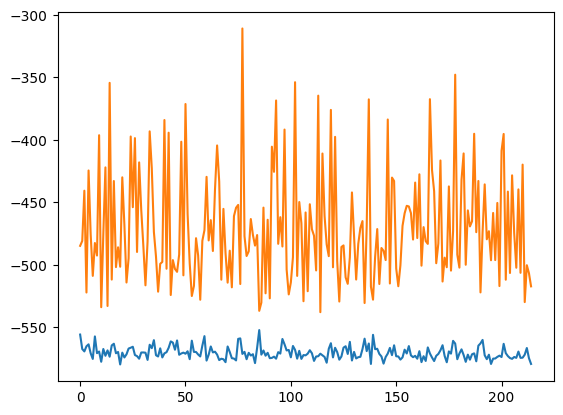

train_weighted_vae: dec
train: iter 0  trainloss -570.89206  validloss -453.50341±0.00000  bestvalidloss -453.50341  last_update 0
train: iter 1  trainloss -574.53794  validloss -429.67086±0.00000  bestvalidloss -453.50341  last_update 1
train: iter 2  trainloss -576.15496  validloss -397.82446±0.00000  bestvalidloss -453.50341  last_update 2
train: iter 3  trainloss -576.16098  validloss -489.26394±0.00000  bestvalidloss -489.26394  last_update 0
train: iter 4  trainloss -574.60567  validloss -514.44269±0.00000  bestvalidloss -514.44269  last_update 0
train: iter 5  trainloss -573.04970  validloss -460.30033±0.00000  bestvalidloss -514.44269  last_update 1
train: iter 6  trainloss -579.53871  validloss -467.58528±0.00000  bestvalidloss -514.44269  last_update 2
train: iter 7  trainloss -574.34630  validloss -463.62510±0.00000  bestvalidloss -514.44269  last_update 3
train: iter 8  trainloss -576.94061  validloss -445.05566±0.00000  bestvalidloss -514.44269  last_update 4
train: iter 9

train: iter 76  trainloss -581.55732  validloss -424.41040±0.00000  bestvalidloss -534.85567  last_update 25
train: iter 77  trainloss -580.77885  validloss -468.74412±0.00000  bestvalidloss -534.85567  last_update 26
train: iter 78  trainloss -578.22041  validloss -367.12305±0.00000  bestvalidloss -534.85567  last_update 27
train: iter 79  trainloss -586.76300  validloss -450.32818±0.00000  bestvalidloss -534.85567  last_update 28
train: iter 80  trainloss -573.63047  validloss -388.46818±0.00000  bestvalidloss -534.85567  last_update 29
train: iter 81  trainloss -588.00462  validloss -466.10960±0.00000  bestvalidloss -534.85567  last_update 30
train: iter 82  trainloss -589.80623  validloss -463.04554±0.00000  bestvalidloss -534.85567  last_update 31
train: iter 83  trainloss -577.63178  validloss -408.33065±0.00000  bestvalidloss -534.85567  last_update 32
train: iter 84  trainloss -578.98473  validloss -448.33481±0.00000  bestvalidloss -534.85567  last_update 33
train: iter 85  tra

train: iter 151  trainloss -579.80368  validloss -398.76124±0.00000  bestvalidloss -534.85567  last_update 100
train: fin


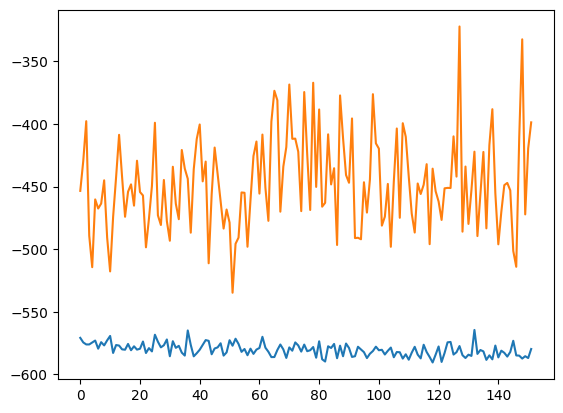

alpha 0.3 vae_lr 0.0005


In [17]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.14637086416137168
1  c = 0.14958754227132484
2  c = 0.10377879598762563
3  c = 0.11522497561967464
4  c = 0.014651445733084967
5  c = 0.2724189324268187
6  c = 0.24067575553558856
7  c = 0.16039779280060013
8  c = 0.1858126778775297
9  c = 0.23343564188706806
10  c = 0.25442966345295354
11  c = 0.10723865580490931
12  c = 0.12693462993613333
13  c = 0.2583874508759422
14  c = 0.10747459186091313
15  c = 0.05424638324465967
16  c = 0.2916759010021025
17  c = 0.0314349456224153
18  c = 0.14255970475518692
19  c = 0.045711780678007075
20  c = 0.1742505406059054
21  c = 0.11969438969478374
22  c = 0.06130293711325025
23  c = 0.2689577509504183
24  c = 0.1882267267495514
25  c = 0.1488736599228234
26  c = 0.27055040121696783
27  c = 0.0909453523261825
28  c = 0.22082650965733186
29  c = 0.24920563291372733
30  c = 0.11277852283941019
31  c = 0.26333948795277096
32  c = 0.2903392694550849
33  c = 0.16779871624473017
34  c = 0.016633082017112888
35  c = 0.27911312425912377
36  c = 0.

98  c = 0.1344102576611782
99  c = 0.2516303871812853
 
実環境方策rollout vs Sim環境方策rollout


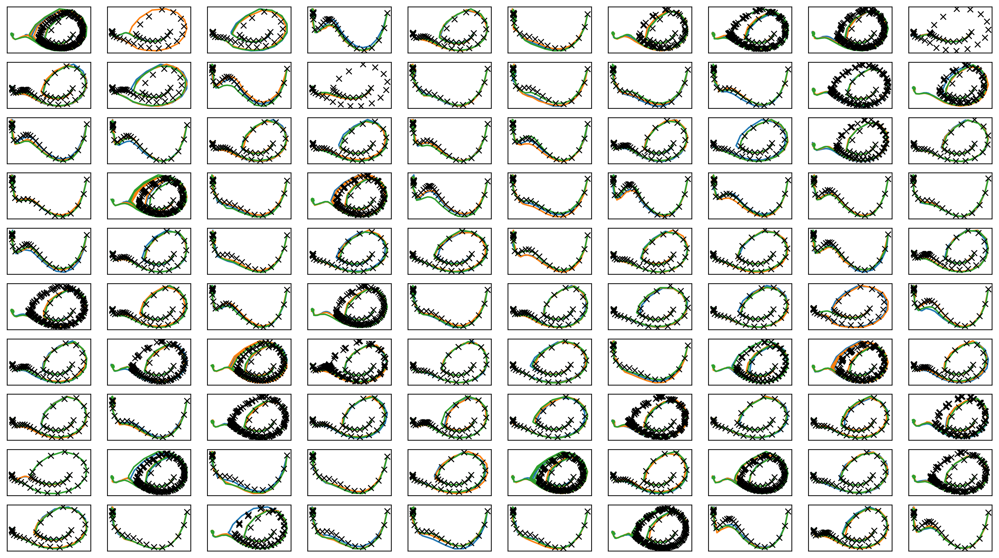

In [18]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter1.png")
plt.savefig(figfilenamehead+"joint_iter1.eps")
plt.savefig(figfilenamehead+"joint_iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

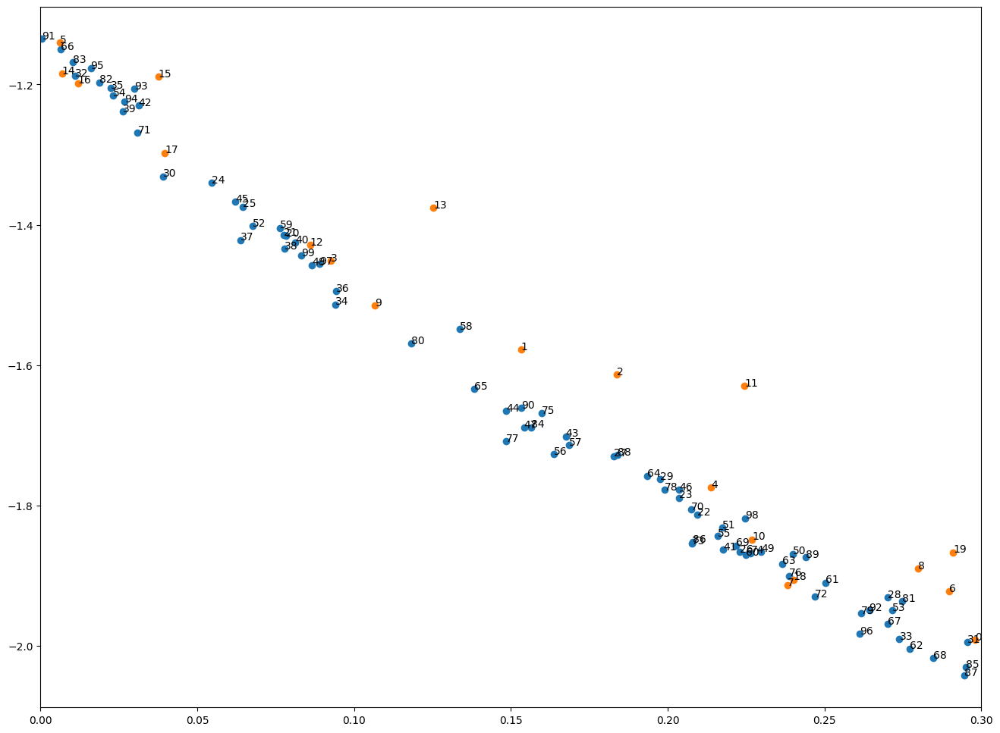

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-03-29 22:12:01.762790


# Iter2

In [21]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.2742245679547049
c = 0.07886887903868657
c = 0.005971300632675103
c = 0.27183085816470665
1  c = 0.06920196397805949
c = 0.052874960093473554
c = 0.2964652828744984
c = 0.2810229672050532
c = 0.17256210367102548
c = 0.19544335354875783
c = 0.0916588223111343
c = 0.2373584533893363
c = 0.09217199218200424
2  c = 0.2824788524066624
c = 0.2634066127956125
c = 0.20166704846108593
c = 0.17530668203562488
c = 0.20990346306623167
c = 0.20301584002950776
c = 0.273210913076011
c = 0.02443423835075137
c = 0.21569280547918301
c = 0.14181785737931116
c = 0.1206436932721418
3  c = 0.003273217008350615
c = 0.20020602382576488
c = 0.25564547337762833
c = 0.13961283560869103
c = 0.20525536835344546
c = 0.008251337717963625
c = 0.02061133489971476
c = 0.03592619144223268
c = 0.14813838735218895
c = 0.27671406025127576
c = 0.028983975444654374
c = 0.2643626458381438
4  c = 0.23946218411420916
c = 0.15643759307176636
c = 0.26458373687243625
c = 0.12714233597653743
c = 0.29743924985773035
5  c = 

c = 0.2734997669475278
c = 0.2361175143254151
39  c = 0.0980860140635212
c = 0.1399194468851377
c = 0.19138208276162233
c = 0.06583737406349467
c = 0.1448371104402206
c = 0.26339105882251657
c = 0.06390743736940233
c = 0.006467515378924404
c = 0.20035843254803617
c = 0.08051351109044814
c = 0.019337140201892044
c = 0.043358490866719314
40  c = 0.22514357785111458
c = 0.29355336716848596
c = 0.26968142901118697
c = 0.29007597147098685
c = 0.21466365126635775
41  c = 0.19374946426179226
c = 0.14803236979661658
c = 0.25261466271339245
c = 0.08224870466899098
c = 0.11960977706543113
c = 0.1699783888542235
c = 0.09420451281006845
42  c = 0.2278887786177639
c = 0.1611449930304604
c = 0.047415094938672596
c = 0.23092988700530298
c = 0.07102459464417096
c = 0.2779822318783711
c = 0.24930491949092654
c = 0.13044252790725977
c = 0.15327198135245326
c = 0.1472868883001213
43  c = 0.2699932634020583
c = 0.2855798871407716
c = 0.11541217822750943
c = 0.06855416302998725
c = 0.13795902783110472
c = 

c = 0.19499760976064492
c = 0.04415091184576183
c = 0.05011385586612027
79  c = 0.24876990432620819
c = 0.27804158627855907
c = 0.15460740196396255
c = 0.24626380894916572
c = 0.08704602726570147
c = 0.037960689345891085
80  c = 0.25136611900366373
c = 0.2200146338271745
c = 0.15116250777015908
c = 0.22826367077952917
c = 0.21009663982804316
c = 0.14553196581851682
c = 0.2390158507118595
c = 0.2880242294526057
c = 0.08895379363933936
c = 0.07375723564005249
81  c = 0.20822839319762476
c = 0.26822210409066183
c = 0.2608341016019983
c = 0.01477042047049336
c = 0.1745542835979431
c = 0.2543036007510837
c = 0.2807644531523845
c = 0.2770901108398531
c = 0.19062194636673846
c = 0.09927164107798263
82  c = 0.13410946871246224
c = 0.1953121717101066
c = 0.2013896151335297
83  c = 0.2117959669506514
c = 0.24365884852411748
c = 0.22293266830393543
c = 0.0032608975467953603
c = 0.09176826669584205
c = 0.013283716234591224
c = 0.2794126838364988
84  c = 0.05116275728574349
c = 0.06490541614007984


In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.23292  validloss 0.36762±0.00000  bestvalidloss 0.36762  last_update 0
train: iter 1  trainloss 0.20996  validloss 0.24020±0.00000  bestvalidloss 0.24020  last_update 0
train: iter 2  trainloss 0.20124  validloss 0.22995±0.00000  bestvalidloss 0.22995  last_update 0
train: iter 3  trainloss 0.19574  validloss 0.22451±0.00000  bestvalidloss 0.22451  last_update 0
train: iter 4  trainloss 0.18963  validloss 0.21843±0.00000  bestvalidloss 0.21843  last_update 0
train: iter 5  trainloss 0.18469  validloss 0.21552±0.00000  bestvalidloss 0.21552  last_update 0
train: iter 6  trainloss 0.18076  validloss 0.21092±0.00000  bestvalidloss 0.21092  last_update 0
train: iter 7  trainloss 0.18005  validloss 0.21349±0.00000  bestvalidloss 0.21092  last_update 1
train: iter 8  trainloss 0.17605  validloss 0.20341±0.00000  bestvalidloss 0.20341  last_update 0
train: iter 9  trainloss 0.17376  validloss 0.20384±0.00000  bestvalidloss 0.20341  last_update 1
train: iter 10  trai

train: iter 83  trainloss 0.15076  validloss 0.17653±0.00000  bestvalidloss 0.17419  last_update 2
train: iter 84  trainloss 0.15086  validloss 0.17470±0.00000  bestvalidloss 0.17419  last_update 3
train: iter 85  trainloss 0.15009  validloss 0.17456±0.00000  bestvalidloss 0.17419  last_update 4
train: iter 86  trainloss 0.15132  validloss 0.17629±0.00000  bestvalidloss 0.17419  last_update 5
train: iter 87  trainloss 0.14996  validloss 0.17700±0.00000  bestvalidloss 0.17419  last_update 6
train: iter 88  trainloss 0.15122  validloss 0.17502±0.00000  bestvalidloss 0.17419  last_update 7
train: iter 89  trainloss 0.15086  validloss 0.17909±0.00000  bestvalidloss 0.17419  last_update 8
train: iter 90  trainloss 0.14995  validloss 0.17862±0.00000  bestvalidloss 0.17419  last_update 9
train: iter 91  trainloss 0.15020  validloss 0.17478±0.00000  bestvalidloss 0.17419  last_update 10
train: iter 92  trainloss 0.15109  validloss 0.17732±0.00000  bestvalidloss 0.17419  last_update 11
train: i

train: iter 168  trainloss 0.14657  validloss 0.17718±0.00000  bestvalidloss 0.17072  last_update 16
train: iter 169  trainloss 0.14534  validloss 0.17115±0.00000  bestvalidloss 0.17072  last_update 17
train: iter 170  trainloss 0.14647  validloss 0.17837±0.00000  bestvalidloss 0.17072  last_update 18
train: iter 171  trainloss 0.14845  validloss 0.17078±0.00000  bestvalidloss 0.17072  last_update 19
train: iter 172  trainloss 0.14543  validloss 0.17121±0.00000  bestvalidloss 0.17072  last_update 20
train: iter 173  trainloss 0.14539  validloss 0.17221±0.00000  bestvalidloss 0.17072  last_update 21
train: iter 174  trainloss 0.14399  validloss 0.17766±0.00000  bestvalidloss 0.17072  last_update 22
train: iter 175  trainloss 0.14622  validloss 0.16979±0.00000  bestvalidloss 0.16979  last_update 0
train: iter 176  trainloss 0.14530  validloss 0.17282±0.00000  bestvalidloss 0.16979  last_update 1
train: iter 177  trainloss 0.14569  validloss 0.17280±0.00000  bestvalidloss 0.16979  last_up

train: iter 252  trainloss 0.14295  validloss 0.17053±0.00000  bestvalidloss 0.16725  last_update 7
train: iter 253  trainloss 0.14199  validloss 0.16769±0.00000  bestvalidloss 0.16725  last_update 8
train: iter 254  trainloss 0.14379  validloss 0.17329±0.00000  bestvalidloss 0.16725  last_update 9
train: iter 255  trainloss 0.14551  validloss 0.17220±0.00000  bestvalidloss 0.16725  last_update 10
train: iter 256  trainloss 0.14327  validloss 0.17010±0.00000  bestvalidloss 0.16725  last_update 11
train: iter 257  trainloss 0.14228  validloss 0.16950±0.00000  bestvalidloss 0.16725  last_update 12
train: iter 258  trainloss 0.14308  validloss 0.16879±0.00000  bestvalidloss 0.16725  last_update 13
train: iter 259  trainloss 0.14160  validloss 0.16801±0.00000  bestvalidloss 0.16725  last_update 14
train: iter 260  trainloss 0.14298  validloss 0.16689±0.00000  bestvalidloss 0.16689  last_update 0
train: iter 261  trainloss 0.14108  validloss 0.16738±0.00000  bestvalidloss 0.16689  last_upda

train: iter 336  trainloss 0.13852  validloss 0.16387±0.00000  bestvalidloss 0.16385  last_update 4
train: iter 337  trainloss 0.14073  validloss 0.17437±0.00000  bestvalidloss 0.16385  last_update 5
train: iter 338  trainloss 0.13902  validloss 0.16504±0.00000  bestvalidloss 0.16385  last_update 6
train: iter 339  trainloss 0.13944  validloss 0.16538±0.00000  bestvalidloss 0.16385  last_update 7
train: iter 340  trainloss 0.14087  validloss 0.16413±0.00000  bestvalidloss 0.16385  last_update 8
train: iter 341  trainloss 0.13996  validloss 0.16674±0.00000  bestvalidloss 0.16385  last_update 9
train: iter 342  trainloss 0.13876  validloss 0.16536±0.00000  bestvalidloss 0.16385  last_update 10
train: iter 343  trainloss 0.14053  validloss 0.16412±0.00000  bestvalidloss 0.16385  last_update 11
train: iter 344  trainloss 0.13856  validloss 0.16430±0.00000  bestvalidloss 0.16385  last_update 12
train: iter 345  trainloss 0.13984  validloss 0.16404±0.00000  bestvalidloss 0.16385  last_update

train: iter 421  trainloss 0.13872  validloss 0.16291±0.00000  bestvalidloss 0.16139  last_update 6
train: iter 422  trainloss 0.13914  validloss 0.16447±0.00000  bestvalidloss 0.16139  last_update 7
train: iter 423  trainloss 0.13697  validloss 0.16573±0.00000  bestvalidloss 0.16139  last_update 8
train: iter 424  trainloss 0.13757  validloss 0.16092±0.00000  bestvalidloss 0.16092  last_update 0
train: iter 425  trainloss 0.13669  validloss 0.16213±0.00000  bestvalidloss 0.16092  last_update 1
train: iter 426  trainloss 0.13726  validloss 0.16203±0.00000  bestvalidloss 0.16092  last_update 2
train: iter 427  trainloss 0.13783  validloss 0.16102±0.00000  bestvalidloss 0.16092  last_update 3
train: iter 428  trainloss 0.13798  validloss 0.16237±0.00000  bestvalidloss 0.16092  last_update 4
train: iter 429  trainloss 0.13785  validloss 0.16598±0.00000  bestvalidloss 0.16092  last_update 5
train: iter 430  trainloss 0.13817  validloss 0.16133±0.00000  bestvalidloss 0.16092  last_update 6


train: iter 506  trainloss 0.13453  validloss 0.16086±0.00000  bestvalidloss 0.15920  last_update 20
train: iter 507  trainloss 0.13613  validloss 0.15976±0.00000  bestvalidloss 0.15920  last_update 21
train: iter 508  trainloss 0.13553  validloss 0.15916±0.00000  bestvalidloss 0.15916  last_update 0
train: iter 509  trainloss 0.13519  validloss 0.15868±0.00000  bestvalidloss 0.15868  last_update 0
train: iter 510  trainloss 0.13509  validloss 0.16241±0.00000  bestvalidloss 0.15868  last_update 1
train: iter 511  trainloss 0.13667  validloss 0.16028±0.00000  bestvalidloss 0.15868  last_update 2
train: iter 512  trainloss 0.13528  validloss 0.16541±0.00000  bestvalidloss 0.15868  last_update 3
train: iter 513  trainloss 0.13501  validloss 0.16287±0.00000  bestvalidloss 0.15868  last_update 4
train: iter 514  trainloss 0.13726  validloss 0.16021±0.00000  bestvalidloss 0.15868  last_update 5
train: iter 515  trainloss 0.13443  validloss 0.15935±0.00000  bestvalidloss 0.15868  last_update 

train: iter 591  trainloss 0.13411  validloss 0.15833±0.00000  bestvalidloss 0.15749  last_update 18
train: iter 592  trainloss 0.13408  validloss 0.15930±0.00000  bestvalidloss 0.15749  last_update 19
train: iter 593  trainloss 0.13270  validloss 0.15658±0.00000  bestvalidloss 0.15658  last_update 0
train: iter 594  trainloss 0.13231  validloss 0.16076±0.00000  bestvalidloss 0.15658  last_update 1
train: iter 595  trainloss 0.13300  validloss 0.15842±0.00000  bestvalidloss 0.15658  last_update 2
train: iter 596  trainloss 0.13412  validloss 0.15931±0.00000  bestvalidloss 0.15658  last_update 3
train: iter 597  trainloss 0.13285  validloss 0.16355±0.00000  bestvalidloss 0.15658  last_update 4
train: iter 598  trainloss 0.13270  validloss 0.16240±0.00000  bestvalidloss 0.15658  last_update 5
train: iter 599  trainloss 0.13385  validloss 0.15957±0.00000  bestvalidloss 0.15658  last_update 6
train: iter 600  trainloss 0.13394  validloss 0.15989±0.00000  bestvalidloss 0.15658  last_update 

train: iter 676  trainloss 0.13088  validloss 0.15611±0.00000  bestvalidloss 0.15535  last_update 3
train: iter 677  trainloss 0.13167  validloss 0.16053±0.00000  bestvalidloss 0.15535  last_update 4
train: iter 678  trainloss 0.13161  validloss 0.15791±0.00000  bestvalidloss 0.15535  last_update 5
train: iter 679  trainloss 0.13140  validloss 0.15545±0.00000  bestvalidloss 0.15535  last_update 6
train: iter 680  trainloss 0.13115  validloss 0.15805±0.00000  bestvalidloss 0.15535  last_update 7
train: iter 681  trainloss 0.13114  validloss 0.15573±0.00000  bestvalidloss 0.15535  last_update 8
train: iter 682  trainloss 0.13074  validloss 0.16445±0.00000  bestvalidloss 0.15535  last_update 9
train: iter 683  trainloss 0.13159  validloss 0.15645±0.00000  bestvalidloss 0.15535  last_update 10
train: iter 684  trainloss 0.13317  validloss 0.15846±0.00000  bestvalidloss 0.15535  last_update 11
train: iter 685  trainloss 0.13147  validloss 0.15677±0.00000  bestvalidloss 0.15535  last_update 

train: iter 760  trainloss 0.12895  validloss 0.15805±0.00000  bestvalidloss 0.15416  last_update 44
train: iter 761  trainloss 0.13103  validloss 0.15628±0.00000  bestvalidloss 0.15416  last_update 45
train: iter 762  trainloss 0.12986  validloss 0.15912±0.00000  bestvalidloss 0.15416  last_update 46
train: iter 763  trainloss 0.13086  validloss 0.15498±0.00000  bestvalidloss 0.15416  last_update 47
train: iter 764  trainloss 0.12991  validloss 0.15935±0.00000  bestvalidloss 0.15416  last_update 48
train: iter 765  trainloss 0.13243  validloss 0.15959±0.00000  bestvalidloss 0.15416  last_update 49
train: iter 766  trainloss 0.12925  validloss 0.15435±0.00000  bestvalidloss 0.15416  last_update 50
train: iter 767  trainloss 0.12979  validloss 0.15429±0.00000  bestvalidloss 0.15416  last_update 51
train: iter 768  trainloss 0.12988  validloss 0.15387±0.00000  bestvalidloss 0.15387  last_update 0
train: iter 769  trainloss 0.13096  validloss 0.15471±0.00000  bestvalidloss 0.15387  last_u

train: iter 845  trainloss 0.13215  validloss 0.15326±0.00000  bestvalidloss 0.15269  last_update 2
train: iter 846  trainloss 0.12880  validloss 0.15753±0.00000  bestvalidloss 0.15269  last_update 3
train: iter 847  trainloss 0.12947  validloss 0.16199±0.00000  bestvalidloss 0.15269  last_update 4
train: iter 848  trainloss 0.12959  validloss 0.15453±0.00000  bestvalidloss 0.15269  last_update 5
train: iter 849  trainloss 0.12900  validloss 0.16064±0.00000  bestvalidloss 0.15269  last_update 6
train: iter 850  trainloss 0.12844  validloss 0.15400±0.00000  bestvalidloss 0.15269  last_update 7
train: iter 851  trainloss 0.12933  validloss 0.15589±0.00000  bestvalidloss 0.15269  last_update 8
train: iter 852  trainloss 0.13048  validloss 0.15785±0.00000  bestvalidloss 0.15269  last_update 9
train: iter 853  trainloss 0.12832  validloss 0.15539±0.00000  bestvalidloss 0.15269  last_update 10
train: iter 854  trainloss 0.13125  validloss 0.15872±0.00000  bestvalidloss 0.15269  last_update 1

train: iter 930  trainloss 0.12773  validloss 0.15491±0.00000  bestvalidloss 0.15205  last_update 20
train: iter 931  trainloss 0.12664  validloss 0.15422±0.00000  bestvalidloss 0.15205  last_update 21
train: iter 932  trainloss 0.12724  validloss 0.15470±0.00000  bestvalidloss 0.15205  last_update 22
train: iter 933  trainloss 0.12743  validloss 0.15346±0.00000  bestvalidloss 0.15205  last_update 23
train: iter 934  trainloss 0.12705  validloss 0.15300±0.00000  bestvalidloss 0.15205  last_update 24
train: iter 935  trainloss 0.12761  validloss 0.15517±0.00000  bestvalidloss 0.15205  last_update 25
train: iter 936  trainloss 0.12734  validloss 0.15760±0.00000  bestvalidloss 0.15205  last_update 26
train: iter 937  trainloss 0.12750  validloss 0.15264±0.00000  bestvalidloss 0.15205  last_update 27
train: iter 938  trainloss 0.12789  validloss 0.15466±0.00000  bestvalidloss 0.15205  last_update 28
train: iter 939  trainloss 0.12833  validloss 0.15579±0.00000  bestvalidloss 0.15205  last_

train: iter 1015  trainloss 0.12753  validloss 0.15279±0.00000  bestvalidloss 0.15126  last_update 67
train: iter 1016  trainloss 0.12679  validloss 0.15327±0.00000  bestvalidloss 0.15126  last_update 68
train: iter 1017  trainloss 0.12722  validloss 0.15904±0.00000  bestvalidloss 0.15126  last_update 69
train: iter 1018  trainloss 0.12596  validloss 0.15217±0.00000  bestvalidloss 0.15126  last_update 70
train: iter 1019  trainloss 0.12688  validloss 0.15327±0.00000  bestvalidloss 0.15126  last_update 71
train: iter 1020  trainloss 0.12632  validloss 0.15385±0.00000  bestvalidloss 0.15126  last_update 72
train: iter 1021  trainloss 0.12579  validloss 0.15590±0.00000  bestvalidloss 0.15126  last_update 73
train: iter 1022  trainloss 0.12746  validloss 0.15456±0.00000  bestvalidloss 0.15126  last_update 74
train: iter 1023  trainloss 0.12621  validloss 0.15259±0.00000  bestvalidloss 0.15126  last_update 75
train: iter 1024  trainloss 0.12664  validloss 0.15176±0.00000  bestvalidloss 0.15

train: iter 1100  trainloss 0.12557  validloss 0.15942±0.00000  bestvalidloss 0.15020  last_update 10
train: iter 1101  trainloss 0.12762  validloss 0.15263±0.00000  bestvalidloss 0.15020  last_update 11
train: iter 1102  trainloss 0.12683  validloss 0.15204±0.00000  bestvalidloss 0.15020  last_update 12
train: iter 1103  trainloss 0.12703  validloss 0.15517±0.00000  bestvalidloss 0.15020  last_update 13
train: iter 1104  trainloss 0.12453  validloss 0.15266±0.00000  bestvalidloss 0.15020  last_update 14
train: iter 1105  trainloss 0.12591  validloss 0.15313±0.00000  bestvalidloss 0.15020  last_update 15
train: iter 1106  trainloss 0.12595  validloss 0.15421±0.00000  bestvalidloss 0.15020  last_update 16
train: iter 1107  trainloss 0.12529  validloss 0.15034±0.00000  bestvalidloss 0.15020  last_update 17
train: iter 1108  trainloss 0.12646  validloss 0.15043±0.00000  bestvalidloss 0.15020  last_update 18
train: iter 1109  trainloss 0.12490  validloss 0.15388±0.00000  bestvalidloss 0.15

train: iter 1185  trainloss 0.12563  validloss 0.15115±0.00000  bestvalidloss 0.14934  last_update 15
train: iter 1186  trainloss 0.12399  validloss 0.14995±0.00000  bestvalidloss 0.14934  last_update 16
train: iter 1187  trainloss 0.12415  validloss 0.15143±0.00000  bestvalidloss 0.14934  last_update 17
train: iter 1188  trainloss 0.12419  validloss 0.15112±0.00000  bestvalidloss 0.14934  last_update 18
train: iter 1189  trainloss 0.12420  validloss 0.15233±0.00000  bestvalidloss 0.14934  last_update 19
train: iter 1190  trainloss 0.12482  validloss 0.15233±0.00000  bestvalidloss 0.14934  last_update 20
train: iter 1191  trainloss 0.12449  validloss 0.15393±0.00000  bestvalidloss 0.14934  last_update 21
train: iter 1192  trainloss 0.12389  validloss 0.15094±0.00000  bestvalidloss 0.14934  last_update 22
train: iter 1193  trainloss 0.12453  validloss 0.15020±0.00000  bestvalidloss 0.14934  last_update 23
train: iter 1194  trainloss 0.12410  validloss 0.15075±0.00000  bestvalidloss 0.14

train: iter 1270  trainloss 0.12344  validloss 0.15070±0.00000  bestvalidloss 0.14908  last_update 54
train: iter 1271  trainloss 0.12335  validloss 0.15030±0.00000  bestvalidloss 0.14908  last_update 55
train: iter 1272  trainloss 0.12438  validloss 0.14997±0.00000  bestvalidloss 0.14908  last_update 56
train: iter 1273  trainloss 0.12506  validloss 0.15206±0.00000  bestvalidloss 0.14908  last_update 57
train: iter 1274  trainloss 0.12349  validloss 0.15090±0.00000  bestvalidloss 0.14908  last_update 58
train: iter 1275  trainloss 0.12466  validloss 0.15281±0.00000  bestvalidloss 0.14908  last_update 59
train: iter 1276  trainloss 0.12313  validloss 0.15441±0.00000  bestvalidloss 0.14908  last_update 60
train: iter 1277  trainloss 0.12443  validloss 0.15276±0.00000  bestvalidloss 0.14908  last_update 61
train: iter 1278  trainloss 0.12336  validloss 0.15280±0.00000  bestvalidloss 0.14908  last_update 62
train: iter 1279  trainloss 0.12328  validloss 0.14956±0.00000  bestvalidloss 0.14

train: iter 1355  trainloss 0.12289  validloss 0.15103±0.00000  bestvalidloss 0.14793  last_update 62
train: iter 1356  trainloss 0.12331  validloss 0.15222±0.00000  bestvalidloss 0.14793  last_update 63
train: iter 1357  trainloss 0.12252  validloss 0.15235±0.00000  bestvalidloss 0.14793  last_update 64
train: iter 1358  trainloss 0.12307  validloss 0.15189±0.00000  bestvalidloss 0.14793  last_update 65
train: iter 1359  trainloss 0.12358  validloss 0.15024±0.00000  bestvalidloss 0.14793  last_update 66
train: iter 1360  trainloss 0.12166  validloss 0.15027±0.00000  bestvalidloss 0.14793  last_update 67
train: iter 1361  trainloss 0.12225  validloss 0.15477±0.00000  bestvalidloss 0.14793  last_update 68
train: iter 1362  trainloss 0.12299  validloss 0.15062±0.00000  bestvalidloss 0.14793  last_update 69
train: iter 1363  trainloss 0.12221  validloss 0.14918±0.00000  bestvalidloss 0.14793  last_update 70
train: iter 1364  trainloss 0.12298  validloss 0.15228±0.00000  bestvalidloss 0.14

In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -124.74469829201698
valid_loss:  -26.378965505361556
train_loss:  -124.5675266075134
valid_loss:  -63.106157126426695


1e-08 1000.0


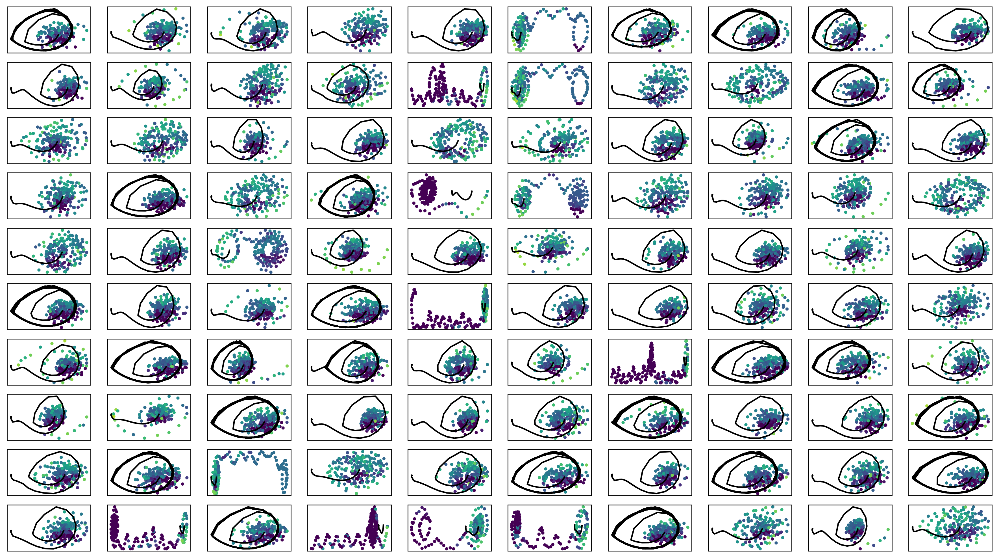

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [25]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [26]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -121.17701  validloss -57.67142±0.00000  bestvalidloss -57.67142  last_update 0
train: iter 1  trainloss -123.25740  validloss -66.24918±0.00000  bestvalidloss -66.24918  last_update 0
train: iter 2  trainloss -120.44171  validloss -56.67720±0.00000  bestvalidloss -66.24918  last_update 1
train: iter 3  trainloss -121.95076  validloss -92.87501±0.00000  bestvalidloss -92.87501  last_update 0
train: iter 4  trainloss -121.87006  validloss -76.59043±0.00000  bestvalidloss -92.87501  last_update 1
train: iter 5  trainloss -121.43068  validloss -98.34514±0.00000  bestvalidloss -98.34514  last_update 0
train: iter 6  trainloss -118.89778  validloss -88.98962±0.00000  bestvalidloss -98.34514  last_update 1
train: iter 7  trainloss -121.90869  validloss -108.75194±0.00000  bestvalidloss -108.75194  last_update 0
train: iter 8  trainloss -119.48527  validloss -90.66840±0.00000  bestvalidloss -108.75194  last_update 1
train: iter 9  trainloss

train: iter 77  trainloss -119.33888  validloss -105.18490±0.00000  bestvalidloss -115.67711  last_update 35
train: iter 78  trainloss -121.66251  validloss -118.16482±0.00000  bestvalidloss -118.16482  last_update 0
train: iter 79  trainloss -120.50383  validloss -79.14794±0.00000  bestvalidloss -118.16482  last_update 1
train: iter 80  trainloss -119.53080  validloss -76.13039±0.00000  bestvalidloss -118.16482  last_update 2
train: iter 81  trainloss -119.24267  validloss -112.13176±0.00000  bestvalidloss -118.16482  last_update 3
train: iter 82  trainloss -121.07708  validloss -53.80156±0.00000  bestvalidloss -118.16482  last_update 4
train: iter 83  trainloss -111.62796  validloss -50.94866±0.00000  bestvalidloss -118.16482  last_update 5
train: iter 84  trainloss -118.07819  validloss -106.94716±0.00000  bestvalidloss -118.16482  last_update 6
train: iter 85  trainloss -120.54735  validloss -81.81601±0.00000  bestvalidloss -118.16482  last_update 7
train: iter 86  trainloss -120.9

train: iter 153  trainloss -119.86910  validloss -105.81727±0.00000  bestvalidloss -118.16482  last_update 75
train: iter 154  trainloss -119.07383  validloss -44.34443±0.00000  bestvalidloss -118.16482  last_update 76
train: iter 155  trainloss -121.17505  validloss -52.03951±0.00000  bestvalidloss -118.16482  last_update 77
train: iter 156  trainloss -119.11308  validloss -57.41339±0.00000  bestvalidloss -118.16482  last_update 78
train: iter 157  trainloss -117.06902  validloss -20.63592±0.00000  bestvalidloss -118.16482  last_update 79
train: iter 158  trainloss -119.71106  validloss -90.29871±0.00000  bestvalidloss -118.16482  last_update 80
train: iter 159  trainloss -117.54889  validloss -66.22528±0.00000  bestvalidloss -118.16482  last_update 81
train: iter 160  trainloss -116.39519  validloss -73.93041±0.00000  bestvalidloss -118.16482  last_update 82
train: iter 161  trainloss -116.91789  validloss -78.84226±0.00000  bestvalidloss -118.16482  last_update 83
train: iter 162  t

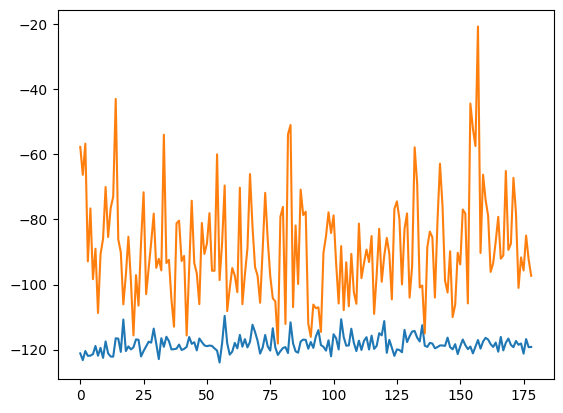

train_weighted_vae: enc
train: iter 0  trainloss -120.16874  validloss -102.71674±0.00000  bestvalidloss -102.71674  last_update 0
train: iter 1  trainloss -119.43233  validloss -101.23644±0.00000  bestvalidloss -102.71674  last_update 1
train: iter 2  trainloss -119.15998  validloss -107.30160±0.00000  bestvalidloss -107.30160  last_update 0
train: iter 3  trainloss -120.61926  validloss -97.17439±0.00000  bestvalidloss -107.30160  last_update 1
train: iter 4  trainloss -122.34614  validloss -108.04680±0.00000  bestvalidloss -108.04680  last_update 0
train: iter 5  trainloss -120.03017  validloss -106.25476±0.00000  bestvalidloss -108.04680  last_update 1
train: iter 6  trainloss -121.75623  validloss -92.22234±0.00000  bestvalidloss -108.04680  last_update 2
train: iter 7  trainloss -121.42578  validloss -98.05890±0.00000  bestvalidloss -108.04680  last_update 3
train: iter 8  trainloss -122.85127  validloss -90.39625±0.00000  bestvalidloss -108.04680  last_update 4
train: iter 9  tr

train: iter 77  trainloss -121.72038  validloss -72.24213±0.00000  bestvalidloss -114.17030  last_update 33
train: iter 78  trainloss -122.77618  validloss -81.63996±0.00000  bestvalidloss -114.17030  last_update 34
train: iter 79  trainloss -123.01981  validloss -83.32577±0.00000  bestvalidloss -114.17030  last_update 35
train: iter 80  trainloss -119.98019  validloss -51.92546±0.00000  bestvalidloss -114.17030  last_update 36
train: iter 81  trainloss -122.06080  validloss -90.17614±0.00000  bestvalidloss -114.17030  last_update 37
train: iter 82  trainloss -119.53301  validloss -94.94772±0.00000  bestvalidloss -114.17030  last_update 38
train: iter 83  trainloss -119.94917  validloss -82.05867±0.00000  bestvalidloss -114.17030  last_update 39
train: iter 84  trainloss -123.48080  validloss -74.95409±0.00000  bestvalidloss -114.17030  last_update 40
train: iter 85  trainloss -122.28168  validloss -95.18037±0.00000  bestvalidloss -114.17030  last_update 41
train: iter 86  trainloss -1

train: iter 153  trainloss -120.25879  validloss -92.00197±0.00000  bestvalidloss -118.35832  last_update 31
train: iter 154  trainloss -121.79548  validloss -104.01441±0.00000  bestvalidloss -118.35832  last_update 32
train: iter 155  trainloss -120.96633  validloss -93.95497±0.00000  bestvalidloss -118.35832  last_update 33
train: iter 156  trainloss -121.56426  validloss -83.49627±0.00000  bestvalidloss -118.35832  last_update 34
train: iter 157  trainloss -121.64687  validloss -89.11599±0.00000  bestvalidloss -118.35832  last_update 35
train: iter 158  trainloss -122.27209  validloss -95.00068±0.00000  bestvalidloss -118.35832  last_update 36
train: iter 159  trainloss -120.74906  validloss -84.86509±0.00000  bestvalidloss -118.35832  last_update 37
train: iter 160  trainloss -121.59693  validloss -110.94629±0.00000  bestvalidloss -118.35832  last_update 38
train: iter 161  trainloss -122.44576  validloss -102.88168±0.00000  bestvalidloss -118.35832  last_update 39
train: iter 162 

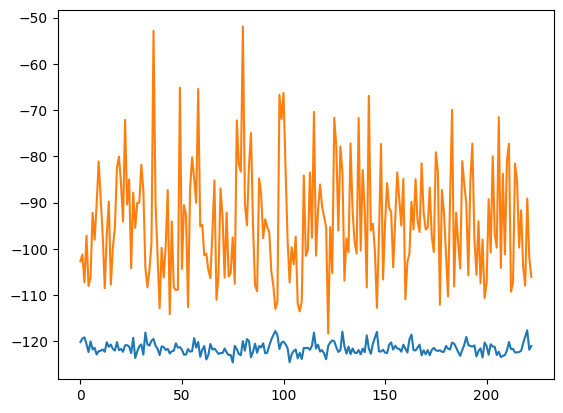

train_weighted_vae: dec
train: iter 0  trainloss -122.13111  validloss -107.52204±0.00000  bestvalidloss -107.52204  last_update 0
train: iter 1  trainloss -120.35451  validloss -96.02316±0.00000  bestvalidloss -107.52204  last_update 1
train: iter 2  trainloss -122.57220  validloss -97.64059±0.00000  bestvalidloss -107.52204  last_update 2
train: iter 3  trainloss -121.76705  validloss -84.03198±0.00000  bestvalidloss -107.52204  last_update 3
train: iter 4  trainloss -121.71541  validloss -84.37261±0.00000  bestvalidloss -107.52204  last_update 4
train: iter 5  trainloss -121.57943  validloss -85.28608±0.00000  bestvalidloss -107.52204  last_update 5
train: iter 6  trainloss -118.42014  validloss -92.21378±0.00000  bestvalidloss -107.52204  last_update 6
train: iter 7  trainloss -121.45934  validloss -92.69792±0.00000  bestvalidloss -107.52204  last_update 7
train: iter 8  trainloss -119.06475  validloss -71.56647±0.00000  bestvalidloss -107.52204  last_update 8
train: iter 9  trainl

train: iter 77  trainloss -118.96975  validloss -85.15839±0.00000  bestvalidloss -107.52204  last_update 77
train: iter 78  trainloss -122.58900  validloss -102.94291±0.00000  bestvalidloss -107.52204  last_update 78
train: iter 79  trainloss -121.56800  validloss -71.76169±0.00000  bestvalidloss -107.52204  last_update 79
train: iter 80  trainloss -121.26104  validloss -77.46040±0.00000  bestvalidloss -107.52204  last_update 80
train: iter 81  trainloss -116.16183  validloss -81.42609±0.00000  bestvalidloss -107.52204  last_update 81
train: iter 82  trainloss -121.97415  validloss -94.05084±0.00000  bestvalidloss -107.52204  last_update 82
train: iter 83  trainloss -122.95678  validloss -98.05817±0.00000  bestvalidloss -107.52204  last_update 83
train: iter 84  trainloss -122.77553  validloss -89.29351±0.00000  bestvalidloss -107.52204  last_update 84
train: iter 85  trainloss -121.91001  validloss -84.89006±0.00000  bestvalidloss -107.52204  last_update 85
train: iter 86  trainloss -

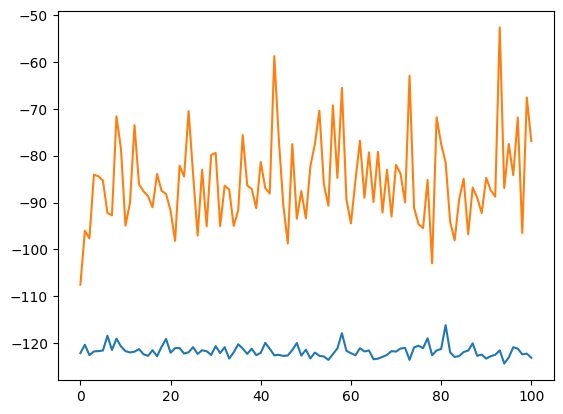

alpha 0.3 vae_lr 0.0005


In [27]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.12963006163765808
1  c = 0.2565586857672717
2  c = 0.21129942588058706
3  c = 0.08663040148759928
4  c = 0.028356884145434146
5  c = 0.05807445474689273
6  c = 0.11025043537180891
7  c = 0.27551583760923004
8  c = 0.22680360827714094
9  c = 0.16275027715196158
10  c = 0.28383859403531697
11  c = 0.07029344009136586
12  c = 0.2779398360412865
13  c = 0.22876834920409764
14  c = 0.13807860181977055
15  c = 0.21604657992151063
16  c = 0.0711604441386705
17  c = 0.10532463879369379
18  c = 0.0016435317722175657
19  c = 0.22107316361652288
20  c = 0.0021274053508450017
21  c = 0.009313619407383344
22  c = 0.2164461168029911
23  c = 0.1010996628154094
24  c = 0.01406302063887984
25  c = 0.0018400784454395414
26  c = 0.11623035628649106
27  c = 0.09873067992433998
28  c = 0.2725855244354759
29  c = 0.0737810370403087
30  c = 0.14728437542547954
31  c = 0.188713418468948
32  c = 0.15062120791374403
33  c = 0.23837690802293415
34  c = 0.23182666688580017
35  c = 0.2435748512776646
36  

97  c = 0.07182960602600985
98  c = 0.13421958701335399
99  c = 0.20947569284533035
 
実環境方策rollout vs Sim環境方策rollout


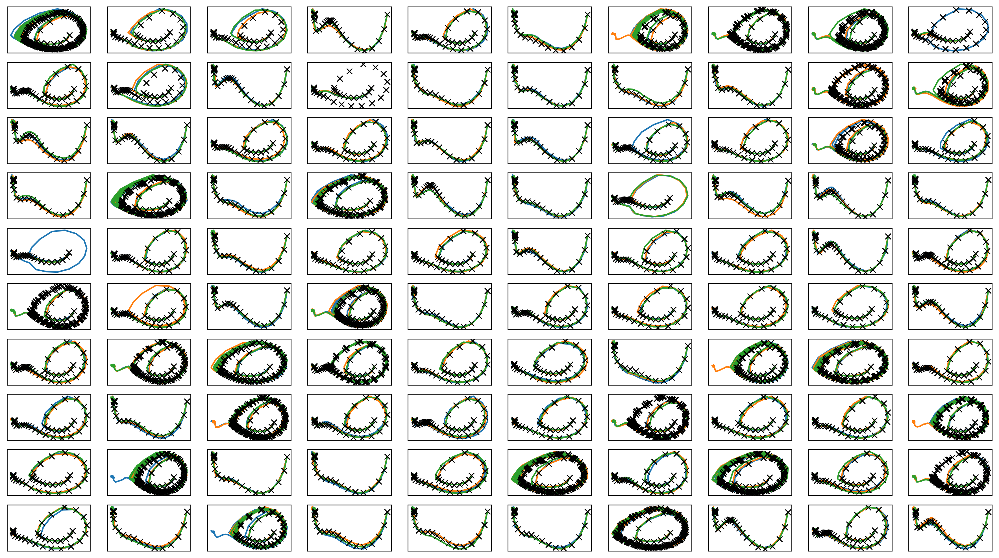

In [28]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

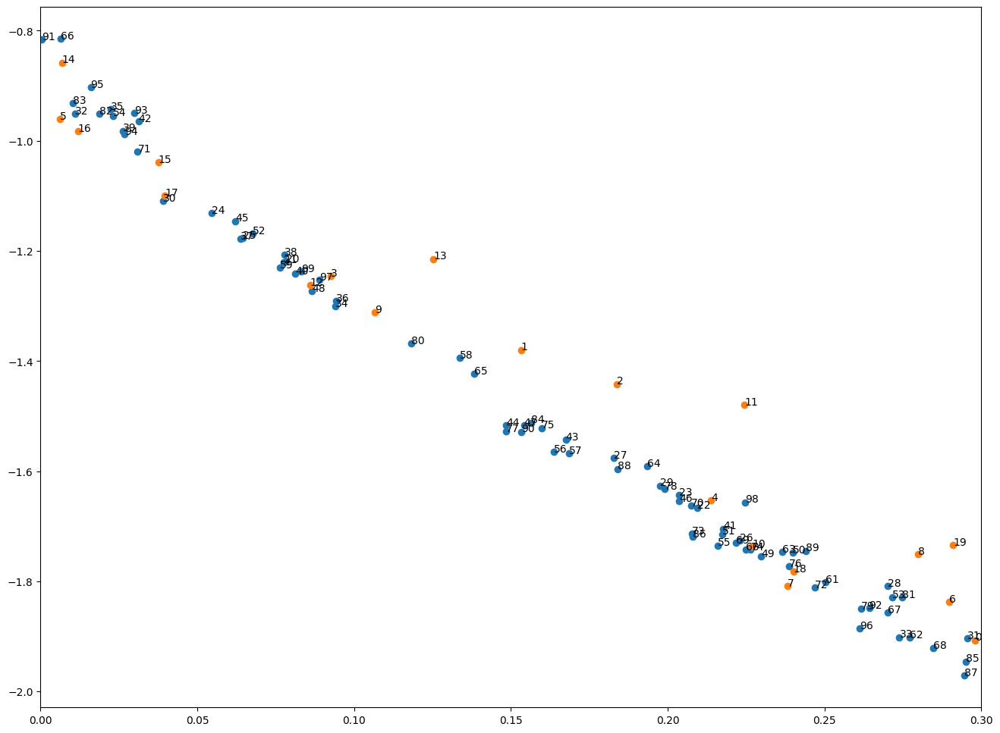

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-03-29 22:15:14.922407


# Iter 3

In [31]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.13473968258013622
c = 0.020879927136093622
c = 0.01164512560803399
c = 0.060390534843363104
c = 0.19369958296865003
c = 0.21769526381084534
c = 0.27683905372013573
c = 0.2929042045405407
c = 0.018354941314563465
c = 0.23486187815581458
1  c = 0.2368036205819356
c = 0.1947059414062948
c = 0.29196812096296604
c = 0.2651556271396102
c = 0.01478182975268204
c = 0.0781063747465702
c = 0.14233464860832992
c = 0.10134777184147571
c = 0.14382040851132197
c = 0.11385992836369263
c = 0.16181977150039148
2  c = 0.0220441835247804
c = 0.003501729953062016
c = 0.1909634321440387
c = 0.07935999059299124
c = 0.14477620463839433
c = 0.26232810331378614
c = 0.16874621858160466
c = 0.28138406712037917
c = 0.1009849463968301
3  c = 0.22794038868242794
c = 0.2290637577160764
c = 0.04373509185232009
c = 0.14449775033585244
c = 0.0070565020645093285
c = 0.2501012851067011
c = 0.17327267631023333
c = 0.12769009936150044
c = 0.04378156996329058
c = 0.15223125404611523
c = 0.17136318923694038
4  c = 0

c = 0.2570778663794059
c = 0.13392588363799857
c = 0.09077134539859859
c = 0.13641888944380182
40  c = 0.25676751228754613
c = 0.15349358638982435
c = 0.031810985938634025
c = 0.23287922381327314
c = 0.13222264963458413
c = 0.17366192188513063
c = 0.06367661225233025
c = 0.23350412723737965
c = 0.019489177978912586
c = 0.26363215769311443
c = 0.024496090408954996
41  c = 0.018777433748862638
c = 0.25496874509860273
c = 0.23634460734105475
c = 0.2031565773618724
42  c = 0.1974063960663662
c = 0.2628673367119624
c = 0.09339274536524078
c = 0.22099718046992664
c = 0.10670848670201388
43  c = 0.09573376292331816
c = 0.25253643028151457
c = 0.117612303359411
c = 0.29880725027439475
c = 0.043127096066713576
c = 0.25834095721812
c = 0.09677334787475929
c = 0.26087817673102165
c = 0.1941940620150699
c = 0.09700474333539161
c = 0.07731487612350564
c = 0.017740987589012214
c = 0.24796828905246437
c = 0.10076224094206007
44  c = 0.020489260459607948
c = 0.0948069637053199
c = 0.08479907531561359


c = 0.14410357064030993
78  c = 0.08258720678758866
c = 0.16912652281363674
c = 0.17030572535614388
c = 0.12538590569824937
79  c = 0.17861504349331941
c = 0.24510327605869373
c = 0.23086568000044314
c = 0.03498669642523173
c = 0.09671061270981508
c = 0.06753989892639457
c = 0.03381041027453215
c = 0.04127597985954335
c = 0.290655956794083
c = 0.17025938289363038
c = 0.0019776149374784668
c = 0.24777559153426937
c = 0.05039953661488537
c = 0.27559883421186043
c = 0.21974441408268258
c = 0.26009436467153846
c = 0.1571777895957095
80  c = 0.035062400287329896
c = 0.0749252695148361
c = 0.16255029020705278
c = 0.0878986040246878
c = 0.04091380526314634
c = 0.27117951807456553
81  c = 0.16547451292259888
c = 0.04913431174883476
c = 0.17470040222583458
c = 0.08186764316836719
c = 0.21244960156629972
c = 0.015985456813289365
82  c = 0.19625610791381845
c = 0.02941209310523869
c = 0.1778580436070342
c = 0.14290106330646288
c = 0.1740211003969297
c = 0.0016682080496320916
c = 0.226816042200889

In [32]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.14926  validloss 0.17629±0.00000  bestvalidloss 0.17629  last_update 0
train: iter 1  trainloss 0.14143  validloss 0.15311±0.00000  bestvalidloss 0.15311  last_update 0
train: iter 2  trainloss 0.14137  validloss 0.15405±0.00000  bestvalidloss 0.15311  last_update 1
train: iter 3  trainloss 0.13968  validloss 0.15264±0.00000  bestvalidloss 0.15264  last_update 0
train: iter 4  trainloss 0.13985  validloss 0.15422±0.00000  bestvalidloss 0.15264  last_update 1
train: iter 5  trainloss 0.13892  validloss 0.15371±0.00000  bestvalidloss 0.15264  last_update 2
train: iter 6  trainloss 0.13848  validloss 0.15184±0.00000  bestvalidloss 0.15184  last_update 0
train: iter 7  trainloss 0.14041  validloss 0.15342±0.00000  bestvalidloss 0.15184  last_update 1
train: iter 8  trainloss 0.13901  validloss 0.16048±0.00000  bestvalidloss 0.15184  last_update 2
train: iter 9  trainloss 0.13822  validloss 0.15338±0.00000  bestvalidloss 0.15184  last_update 3
train: iter 10  trai

train: iter 84  trainloss 0.13358  validloss 0.14975±0.00000  bestvalidloss 0.14966  last_update 9
train: iter 85  trainloss 0.13538  validloss 0.15119±0.00000  bestvalidloss 0.14966  last_update 10
train: iter 86  trainloss 0.13426  validloss 0.15382±0.00000  bestvalidloss 0.14966  last_update 11
train: iter 87  trainloss 0.13421  validloss 0.15201±0.00000  bestvalidloss 0.14966  last_update 12
train: iter 88  trainloss 0.13600  validloss 0.15816±0.00000  bestvalidloss 0.14966  last_update 13
train: iter 89  trainloss 0.13471  validloss 0.15074±0.00000  bestvalidloss 0.14966  last_update 14
train: iter 90  trainloss 0.13540  validloss 0.15154±0.00000  bestvalidloss 0.14966  last_update 15
train: iter 91  trainloss 0.13507  validloss 0.15626±0.00000  bestvalidloss 0.14966  last_update 16
train: iter 92  trainloss 0.13467  validloss 0.15102±0.00000  bestvalidloss 0.14966  last_update 17
train: iter 93  trainloss 0.13489  validloss 0.15009±0.00000  bestvalidloss 0.14966  last_update 18
t

train: iter 169  trainloss 0.13303  validloss 0.15083±0.00000  bestvalidloss 0.14898  last_update 7
train: iter 170  trainloss 0.13224  validloss 0.15208±0.00000  bestvalidloss 0.14898  last_update 8
train: iter 171  trainloss 0.13311  validloss 0.15396±0.00000  bestvalidloss 0.14898  last_update 9
train: iter 172  trainloss 0.13372  validloss 0.15531±0.00000  bestvalidloss 0.14898  last_update 10
train: iter 173  trainloss 0.13279  validloss 0.15073±0.00000  bestvalidloss 0.14898  last_update 11
train: iter 174  trainloss 0.13231  validloss 0.15498±0.00000  bestvalidloss 0.14898  last_update 12
train: iter 175  trainloss 0.13215  validloss 0.15242±0.00000  bestvalidloss 0.14898  last_update 13
train: iter 176  trainloss 0.13216  validloss 0.15177±0.00000  bestvalidloss 0.14898  last_update 14
train: iter 177  trainloss 0.13250  validloss 0.15195±0.00000  bestvalidloss 0.14898  last_update 15
train: iter 178  trainloss 0.13206  validloss 0.15119±0.00000  bestvalidloss 0.14898  last_upd

train: iter 254  trainloss 0.13072  validloss 0.14926±0.00000  bestvalidloss 0.14866  last_update 12
train: iter 255  trainloss 0.13100  validloss 0.14895±0.00000  bestvalidloss 0.14866  last_update 13
train: iter 256  trainloss 0.13277  validloss 0.14974±0.00000  bestvalidloss 0.14866  last_update 14
train: iter 257  trainloss 0.13214  validloss 0.14905±0.00000  bestvalidloss 0.14866  last_update 15
train: iter 258  trainloss 0.13401  validloss 0.15013±0.00000  bestvalidloss 0.14866  last_update 16
train: iter 259  trainloss 0.13111  validloss 0.14842±0.00000  bestvalidloss 0.14842  last_update 0
train: iter 260  trainloss 0.13032  validloss 0.14919±0.00000  bestvalidloss 0.14842  last_update 1
train: iter 261  trainloss 0.13108  validloss 0.14993±0.00000  bestvalidloss 0.14842  last_update 2
train: iter 262  trainloss 0.13264  validloss 0.14947±0.00000  bestvalidloss 0.14842  last_update 3
train: iter 263  trainloss 0.13270  validloss 0.15026±0.00000  bestvalidloss 0.14842  last_upda

train: iter 339  trainloss 0.12964  validloss 0.14768±0.00000  bestvalidloss 0.14724  last_update 21
train: iter 340  trainloss 0.12944  validloss 0.15056±0.00000  bestvalidloss 0.14724  last_update 22
train: iter 341  trainloss 0.12988  validloss 0.14808±0.00000  bestvalidloss 0.14724  last_update 23
train: iter 342  trainloss 0.12933  validloss 0.15266±0.00000  bestvalidloss 0.14724  last_update 24
train: iter 343  trainloss 0.13049  validloss 0.14924±0.00000  bestvalidloss 0.14724  last_update 25
train: iter 344  trainloss 0.12934  validloss 0.15119±0.00000  bestvalidloss 0.14724  last_update 26
train: iter 345  trainloss 0.12898  validloss 0.14769±0.00000  bestvalidloss 0.14724  last_update 27
train: iter 346  trainloss 0.13010  validloss 0.15345±0.00000  bestvalidloss 0.14724  last_update 28
train: iter 347  trainloss 0.13001  validloss 0.14937±0.00000  bestvalidloss 0.14724  last_update 29
train: iter 348  trainloss 0.13036  validloss 0.14773±0.00000  bestvalidloss 0.14724  last_

train: iter 424  trainloss 0.12848  validloss 0.15386±0.00000  bestvalidloss 0.14605  last_update 32
train: iter 425  trainloss 0.12901  validloss 0.14767±0.00000  bestvalidloss 0.14605  last_update 33
train: iter 426  trainloss 0.12888  validloss 0.14813±0.00000  bestvalidloss 0.14605  last_update 34
train: iter 427  trainloss 0.12950  validloss 0.15632±0.00000  bestvalidloss 0.14605  last_update 35
train: iter 428  trainloss 0.12905  validloss 0.14820±0.00000  bestvalidloss 0.14605  last_update 36
train: iter 429  trainloss 0.12797  validloss 0.15042±0.00000  bestvalidloss 0.14605  last_update 37
train: iter 430  trainloss 0.12864  validloss 0.14805±0.00000  bestvalidloss 0.14605  last_update 38
train: iter 431  trainloss 0.12763  validloss 0.14666±0.00000  bestvalidloss 0.14605  last_update 39
train: iter 432  trainloss 0.12814  validloss 0.14706±0.00000  bestvalidloss 0.14605  last_update 40
train: iter 433  trainloss 0.12891  validloss 0.15131±0.00000  bestvalidloss 0.14605  last_

train: iter 509  trainloss 0.12677  validloss 0.14650±0.00000  bestvalidloss 0.14548  last_update 22
train: iter 510  trainloss 0.12730  validloss 0.14571±0.00000  bestvalidloss 0.14548  last_update 23
train: iter 511  trainloss 0.12859  validloss 0.14910±0.00000  bestvalidloss 0.14548  last_update 24
train: iter 512  trainloss 0.12767  validloss 0.14822±0.00000  bestvalidloss 0.14548  last_update 25
train: iter 513  trainloss 0.12679  validloss 0.14713±0.00000  bestvalidloss 0.14548  last_update 26
train: iter 514  trainloss 0.12945  validloss 0.14782±0.00000  bestvalidloss 0.14548  last_update 27
train: iter 515  trainloss 0.12723  validloss 0.14983±0.00000  bestvalidloss 0.14548  last_update 28
train: iter 516  trainloss 0.12705  validloss 0.14657±0.00000  bestvalidloss 0.14548  last_update 29
train: iter 517  trainloss 0.12700  validloss 0.14534±0.00000  bestvalidloss 0.14534  last_update 0
train: iter 518  trainloss 0.12718  validloss 0.14789±0.00000  bestvalidloss 0.14534  last_u

train: iter 594  trainloss 0.12625  validloss 0.14745±0.00000  bestvalidloss 0.14478  last_update 21
train: iter 595  trainloss 0.12750  validloss 0.14548±0.00000  bestvalidloss 0.14478  last_update 22
train: iter 596  trainloss 0.12624  validloss 0.14604±0.00000  bestvalidloss 0.14478  last_update 23
train: iter 597  trainloss 0.12596  validloss 0.14447±0.00000  bestvalidloss 0.14447  last_update 0
train: iter 598  trainloss 0.12593  validloss 0.14675±0.00000  bestvalidloss 0.14447  last_update 1
train: iter 599  trainloss 0.12584  validloss 0.14441±0.00000  bestvalidloss 0.14441  last_update 0
train: iter 600  trainloss 0.12620  validloss 0.14480±0.00000  bestvalidloss 0.14441  last_update 1
train: iter 601  trainloss 0.12691  validloss 0.15518±0.00000  bestvalidloss 0.14441  last_update 2
train: iter 602  trainloss 0.12600  validloss 0.14747±0.00000  bestvalidloss 0.14441  last_update 3
train: iter 603  trainloss 0.12597  validloss 0.14668±0.00000  bestvalidloss 0.14441  last_update

train: iter 678  trainloss 0.12646  validloss 0.14699±0.00000  bestvalidloss 0.14441  last_update 79
train: iter 679  trainloss 0.12698  validloss 0.14674±0.00000  bestvalidloss 0.14441  last_update 80
train: iter 680  trainloss 0.12535  validloss 0.14570±0.00000  bestvalidloss 0.14441  last_update 81
train: iter 681  trainloss 0.12615  validloss 0.14859±0.00000  bestvalidloss 0.14441  last_update 82
train: iter 682  trainloss 0.12569  validloss 0.14590±0.00000  bestvalidloss 0.14441  last_update 83
train: iter 683  trainloss 0.12696  validloss 0.14505±0.00000  bestvalidloss 0.14441  last_update 84
train: iter 684  trainloss 0.12538  validloss 0.15015±0.00000  bestvalidloss 0.14441  last_update 85
train: iter 685  trainloss 0.12592  validloss 0.14730±0.00000  bestvalidloss 0.14441  last_update 86
train: iter 686  trainloss 0.12603  validloss 0.14708±0.00000  bestvalidloss 0.14441  last_update 87
train: iter 687  trainloss 0.12559  validloss 0.14747±0.00000  bestvalidloss 0.14441  last_

In [33]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -152.9847681105137
valid_loss:  -118.58691432476044
train_loss:  -158.05895993828776
valid_loss:  -107.50976281404496


1e-08 1000.0


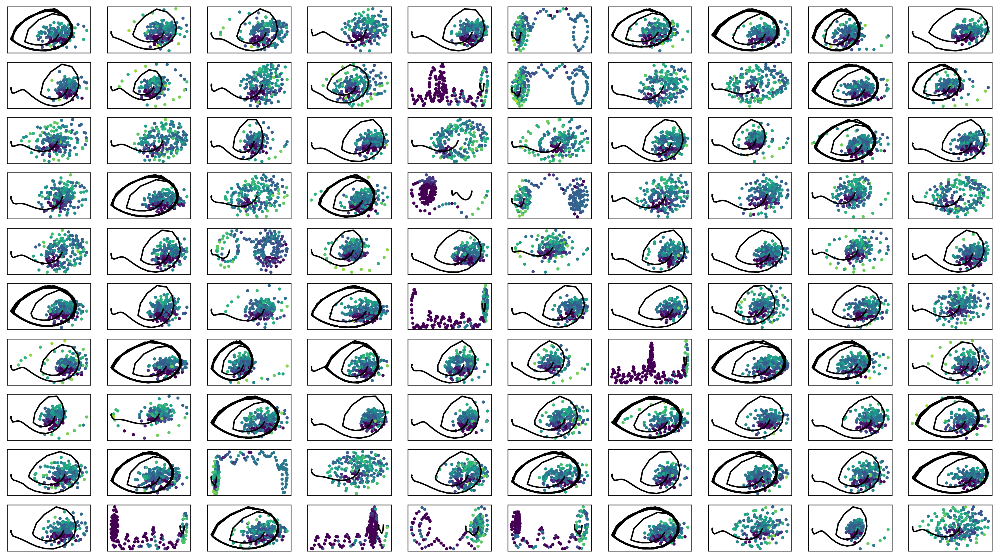

In [34]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [35]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [36]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [37]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -151.25357  validloss -106.44179±0.00000  bestvalidloss -106.44179  last_update 0
train: iter 1  trainloss -150.50492  validloss -74.12443±0.00000  bestvalidloss -106.44179  last_update 1
train: iter 2  trainloss -155.12968  validloss -71.63796±0.00000  bestvalidloss -106.44179  last_update 2
train: iter 3  trainloss -143.00974  validloss -102.68226±0.00000  bestvalidloss -106.44179  last_update 3
train: iter 4  trainloss -154.70765  validloss -126.57083±0.00000  bestvalidloss -126.57083  last_update 0
train: iter 5  trainloss -149.59423  validloss -121.63303±0.00000  bestvalidloss -126.57083  last_update 1
train: iter 6  trainloss -147.76416  validloss -112.47846±0.00000  bestvalidloss -126.57083  last_update 2
train: iter 7  trainloss -154.04064  validloss -122.12369±0.00000  bestvalidloss -126.57083  last_update 3
train: iter 8  trainloss -155.15012  validloss -108.47635±0.00000  bestvalidloss -126.57083  last_update 4
train: iter

train: iter 76  trainloss -147.39012  validloss -118.93398±0.00000  bestvalidloss -145.64713  last_update 29
train: iter 77  trainloss -151.46068  validloss -137.22215±0.00000  bestvalidloss -145.64713  last_update 30
train: iter 78  trainloss -154.86572  validloss -123.39156±0.00000  bestvalidloss -145.64713  last_update 31
train: iter 79  trainloss -154.45453  validloss -91.31221±0.00000  bestvalidloss -145.64713  last_update 32
train: iter 80  trainloss -154.48783  validloss -104.73482±0.00000  bestvalidloss -145.64713  last_update 33
train: iter 81  trainloss -145.54316  validloss -108.40786±0.00000  bestvalidloss -145.64713  last_update 34
train: iter 82  trainloss -154.82474  validloss -141.49599±0.00000  bestvalidloss -145.64713  last_update 35
train: iter 83  trainloss -150.72657  validloss -83.55726±0.00000  bestvalidloss -145.64713  last_update 36
train: iter 84  trainloss -154.20809  validloss -82.04101±0.00000  bestvalidloss -145.64713  last_update 37
train: iter 85  trainl

train: iter 151  trainloss -153.52137  validloss -130.78419±0.00000  bestvalidloss -149.59437  last_update 6
train: iter 152  trainloss -150.03730  validloss -115.63148±0.00000  bestvalidloss -149.59437  last_update 7
train: iter 153  trainloss -150.90706  validloss -131.87131±0.00000  bestvalidloss -149.59437  last_update 8
train: iter 154  trainloss -153.21264  validloss -83.62639±0.00000  bestvalidloss -149.59437  last_update 9
train: iter 155  trainloss -154.36634  validloss -112.47665±0.00000  bestvalidloss -149.59437  last_update 10
train: iter 156  trainloss -152.24022  validloss -117.52688±0.00000  bestvalidloss -149.59437  last_update 11
train: iter 157  trainloss -152.17842  validloss -99.56074±0.00000  bestvalidloss -149.59437  last_update 12
train: iter 158  trainloss -152.99050  validloss -113.29740±0.00000  bestvalidloss -149.59437  last_update 13
train: iter 159  trainloss -153.94164  validloss -115.06540±0.00000  bestvalidloss -149.59437  last_update 14
train: iter 160 

train: iter 226  trainloss -154.07019  validloss -118.27515±0.00000  bestvalidloss -149.59437  last_update 81
train: iter 227  trainloss -156.92449  validloss -126.39412±0.00000  bestvalidloss -149.59437  last_update 82
train: iter 228  trainloss -157.66436  validloss -102.90573±0.00000  bestvalidloss -149.59437  last_update 83
train: iter 229  trainloss -157.42687  validloss -109.44500±0.00000  bestvalidloss -149.59437  last_update 84
train: iter 230  trainloss -154.67896  validloss -96.71902±0.00000  bestvalidloss -149.59437  last_update 85
train: iter 231  trainloss -154.84008  validloss -100.93931±0.00000  bestvalidloss -149.59437  last_update 86
train: iter 232  trainloss -151.69258  validloss -53.96949±0.00000  bestvalidloss -149.59437  last_update 87
train: iter 233  trainloss -154.43643  validloss -75.22521±0.00000  bestvalidloss -149.59437  last_update 88
train: iter 234  trainloss -157.43069  validloss -140.12203±0.00000  bestvalidloss -149.59437  last_update 89
train: iter 2

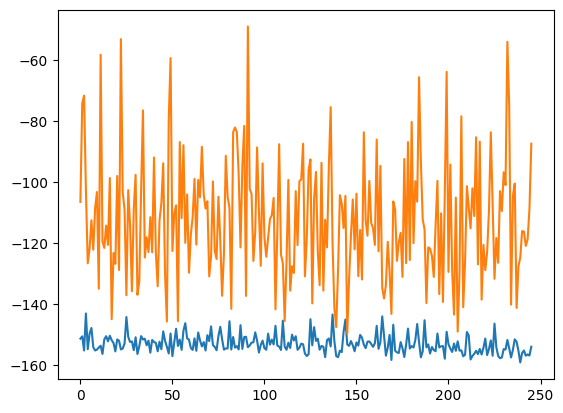

train_weighted_vae: enc
train: iter 0  trainloss -156.54719  validloss -138.28205±0.00000  bestvalidloss -138.28205  last_update 0
train: iter 1  trainloss -158.80748  validloss -105.05847±0.00000  bestvalidloss -138.28205  last_update 1
train: iter 2  trainloss -153.99374  validloss -83.33150±0.00000  bestvalidloss -138.28205  last_update 2
train: iter 3  trainloss -156.43977  validloss -134.19949±0.00000  bestvalidloss -138.28205  last_update 3
train: iter 4  trainloss -157.21695  validloss -102.33629±0.00000  bestvalidloss -138.28205  last_update 4
train: iter 5  trainloss -157.18463  validloss -97.10364±0.00000  bestvalidloss -138.28205  last_update 5
train: iter 6  trainloss -157.18943  validloss -128.39339±0.00000  bestvalidloss -138.28205  last_update 6
train: iter 7  trainloss -154.96143  validloss -92.33436±0.00000  bestvalidloss -138.28205  last_update 7
train: iter 8  trainloss -157.24170  validloss -135.96330±0.00000  bestvalidloss -138.28205  last_update 8
train: iter 9  t

train: iter 76  trainloss -158.74372  validloss -121.38873±0.00000  bestvalidloss -143.75576  last_update 1
train: iter 77  trainloss -156.42152  validloss -120.33840±0.00000  bestvalidloss -143.75576  last_update 2
train: iter 78  trainloss -157.00586  validloss -119.82770±0.00000  bestvalidloss -143.75576  last_update 3
train: iter 79  trainloss -158.40468  validloss -118.57706±0.00000  bestvalidloss -143.75576  last_update 4
train: iter 80  trainloss -155.11377  validloss -101.68998±0.00000  bestvalidloss -143.75576  last_update 5
train: iter 81  trainloss -158.09330  validloss -131.05320±0.00000  bestvalidloss -143.75576  last_update 6
train: iter 82  trainloss -158.07926  validloss -115.21955±0.00000  bestvalidloss -143.75576  last_update 7
train: iter 83  trainloss -157.21355  validloss -114.63979±0.00000  bestvalidloss -143.75576  last_update 8
train: iter 84  trainloss -159.48780  validloss -112.12589±0.00000  bestvalidloss -143.75576  last_update 9
train: iter 85  trainloss -1

train: iter 153  trainloss -158.68181  validloss -131.76991±0.00000  bestvalidloss -146.17150  last_update 45
train: iter 154  trainloss -158.65525  validloss -113.52914±0.00000  bestvalidloss -146.17150  last_update 46
train: iter 155  trainloss -159.93718  validloss -125.56806±0.00000  bestvalidloss -146.17150  last_update 47
train: iter 156  trainloss -157.18983  validloss -113.31643±0.00000  bestvalidloss -146.17150  last_update 48
train: iter 157  trainloss -156.43788  validloss -118.49962±0.00000  bestvalidloss -146.17150  last_update 49
train: iter 158  trainloss -156.22477  validloss -104.24046±0.00000  bestvalidloss -146.17150  last_update 50
train: iter 159  trainloss -157.82117  validloss -136.99605±0.00000  bestvalidloss -146.17150  last_update 51
train: iter 160  trainloss -157.48312  validloss -93.45713±0.00000  bestvalidloss -146.17150  last_update 52
train: iter 161  trainloss -156.20440  validloss -121.14727±0.00000  bestvalidloss -146.17150  last_update 53
train: iter

train: iter 228  trainloss -157.44611  validloss -117.21641±0.00000  bestvalidloss -152.74937  last_update 51
train: iter 229  trainloss -159.16196  validloss -107.51686±0.00000  bestvalidloss -152.74937  last_update 52
train: iter 230  trainloss -157.91634  validloss -136.29405±0.00000  bestvalidloss -152.74937  last_update 53
train: iter 231  trainloss -151.87436  validloss -133.42267±0.00000  bestvalidloss -152.74937  last_update 54
train: iter 232  trainloss -156.05157  validloss -142.33669±0.00000  bestvalidloss -152.74937  last_update 55
train: iter 233  trainloss -154.24431  validloss -127.34728±0.00000  bestvalidloss -152.74937  last_update 56
train: iter 234  trainloss -156.92458  validloss -134.79422±0.00000  bestvalidloss -152.74937  last_update 57
train: iter 235  trainloss -157.39493  validloss -113.43110±0.00000  bestvalidloss -152.74937  last_update 58
train: iter 236  trainloss -157.54095  validloss -135.51096±0.00000  bestvalidloss -152.74937  last_update 59
train: ite

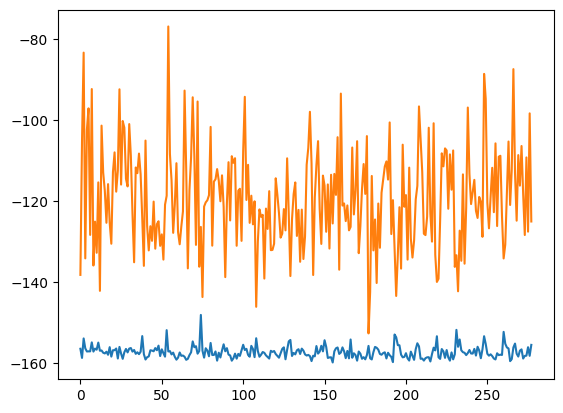

train_weighted_vae: dec
train: iter 0  trainloss -156.57929  validloss -128.73490±0.00000  bestvalidloss -128.73490  last_update 0
train: iter 1  trainloss -156.27533  validloss -77.58962±0.00000  bestvalidloss -128.73490  last_update 1
train: iter 2  trainloss -158.69431  validloss -105.51633±0.00000  bestvalidloss -128.73490  last_update 2
train: iter 3  trainloss -158.34205  validloss -122.59161±0.00000  bestvalidloss -128.73490  last_update 3
train: iter 4  trainloss -158.40086  validloss -95.24216±0.00000  bestvalidloss -128.73490  last_update 4
train: iter 5  trainloss -152.90885  validloss -100.95528±0.00000  bestvalidloss -128.73490  last_update 5
train: iter 6  trainloss -156.69799  validloss -110.06701±0.00000  bestvalidloss -128.73490  last_update 6
train: iter 7  trainloss -157.24369  validloss -100.61650±0.00000  bestvalidloss -128.73490  last_update 7
train: iter 8  trainloss -158.47834  validloss -104.22459±0.00000  bestvalidloss -128.73490  last_update 8
train: iter 9  

train: iter 77  trainloss -157.46240  validloss -43.01596±0.00000  bestvalidloss -128.73490  last_update 77
train: iter 78  trainloss -159.33703  validloss -83.74552±0.00000  bestvalidloss -128.73490  last_update 78
train: iter 79  trainloss -159.17010  validloss -93.05080±0.00000  bestvalidloss -128.73490  last_update 79
train: iter 80  trainloss -158.57349  validloss -91.60232±0.00000  bestvalidloss -128.73490  last_update 80
train: iter 81  trainloss -156.87120  validloss -60.16527±0.00000  bestvalidloss -128.73490  last_update 81
train: iter 82  trainloss -153.73883  validloss -89.31066±0.00000  bestvalidloss -128.73490  last_update 82
train: iter 83  trainloss -155.97423  validloss -100.60365±0.00000  bestvalidloss -128.73490  last_update 83
train: iter 84  trainloss -157.98949  validloss -93.65742±0.00000  bestvalidloss -128.73490  last_update 84
train: iter 85  trainloss -159.88442  validloss -103.36216±0.00000  bestvalidloss -128.73490  last_update 85
train: iter 86  trainloss 

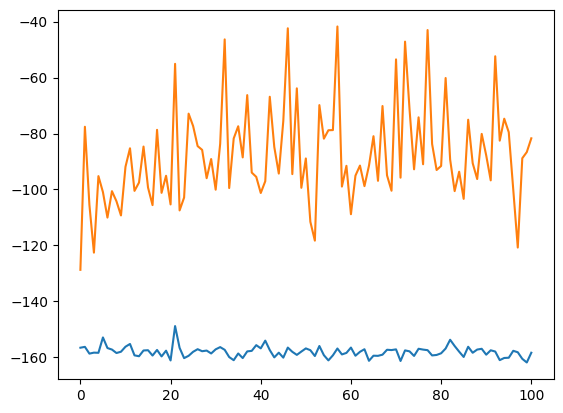

alpha 0.3 vae_lr 0.0005


In [38]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.05184824304935028
1  c = 0.2529391340532123
2  c = 0.21376889785084127
3  c = 0.049242850021030314
4  c = 0.16347204767156714
5  c = 0.046266321936966524
6  c = 0.07298523868330284
7  c = 0.11594503856006243
8  c = 0.28948958889092186
9  c = 0.0909954389771499
10  c = 0.17319521138263477
11  c = 0.06307724053242084
12  c = 0.018607274027982533
13  c = 0.06577708016165242
14  c = 0.28078295434883027
15  c = 0.1855889792054566
16  c = 0.1046438020364191
17  c = 0.04320551789072944
18  c = 0.14863585755184278
19  c = 0.08767469010567959
20  c = 0.09772915530136912
21  c = 0.15682756907447862
22  c = 0.23348309301967343
23  c = 0.09953450322230079
24  c = 0.07772897787435175
25  c = 0.14677575037157922
26  c = 0.15102513994797848
27  c = 0.19555185810762096
28  c = 0.25356863125675777
29  c = 0.05422210287009758
30  c = 0.08144398896225649
31  c = 0.04195482389959269
32  c = 0.19768150169595647
33  c = 0.05169613877697882
34  c = 0.019792360038457444
35  c = 0.14072353866864032
36

95  c = 0.2742154466041417
96  c = 0.24843531467961727
97  c = 0.29649256804626567
98  c = 0.07426741897378726
99  c = 0.0034108935951333796
 
実環境方策rollout vs Sim環境方策rollout


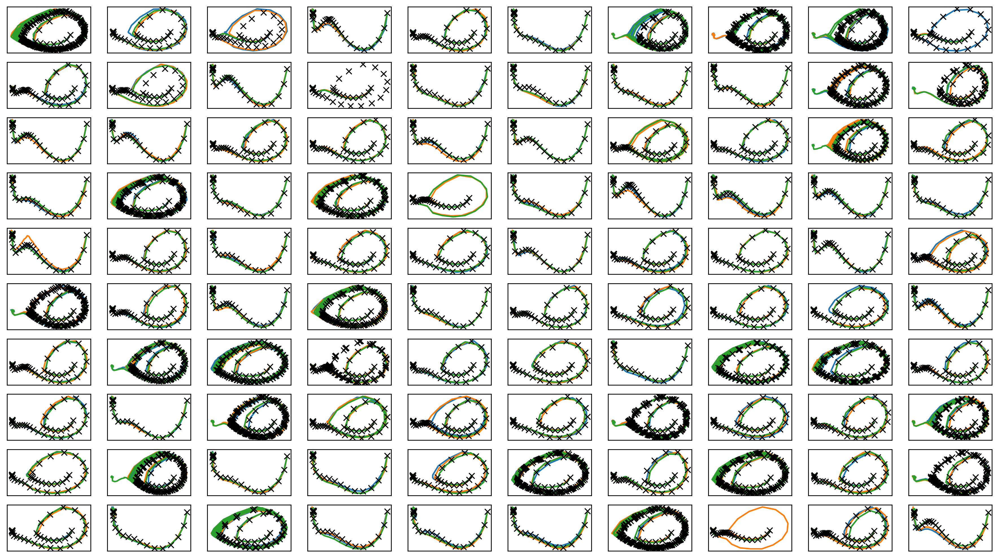

In [39]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

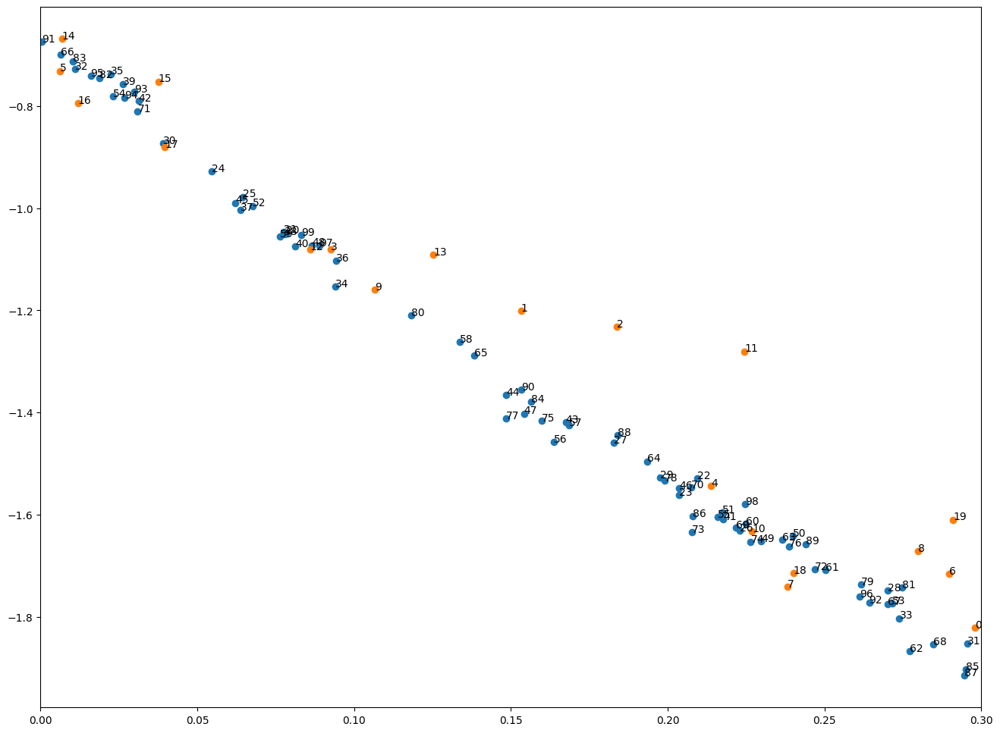

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [40]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [41]:
print(datetime.datetime.now())

2023-03-29 22:18:45.347174


# Iter 4

In [42]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.1291416903324736
c = 0.04113112631306058
c = 0.17125202577141815
c = 0.21655731560520555
c = 0.059042082329986964
c = 0.2626902348210787
c = 0.2819918983400506
c = 0.2038275886670018
c = 0.2913163677031838
c = 0.2110655093748364
c = 0.1283572662870152
c = 0.0183477364851778
c = 0.17157822056335734
1  c = 0.2508005840107313
c = 0.11023634107649734
c = 0.17900302857242284
c = 0.2523260643595241
c = 0.06447531415786245
c = 0.14288262635126792
c = 0.2805254509335254
c = 0.20578259088291026
c = 0.1946622902209769
c = 0.2200925309038579
2  c = 0.06796860212693684
c = 0.1933800856311533
c = 0.12552678627528377
c = 0.06115402698841865
c = 0.22844931029942506
c = 0.26170772211176835
c = 0.10485382596289561
c = 0.20099666722493298
c = 0.23390988265757606
c = 0.07331758819729203
c = 0.03791677817306231
c = 0.19195498343581271
c = 0.06689745682612563
c = 0.2610548169126173
3  c = 0.29545643762616053
c = 0.225321800269851
c = 0.020682244513117752
c = 0.27340072917331026
c = 0.0225243193721

c = 0.19542432974473403
c = 0.1525121607683708
c = 0.1508023756740068
c = 0.001066179099139841
c = 0.21172272022099234
39  c = 0.1939547116737133
c = 0.211044350028902
c = 0.05094401816172543
c = 0.030442474355693114
c = 0.16878244679569904
c = 0.18396426817076242
c = 0.06283336843175953
c = 0.15698364978733217
c = 0.26833200457066475
c = 0.1789586352072164
c = 0.018639526806702333
c = 0.16748652908720477
c = 0.057564925425216705
c = 0.19063831395663497
c = 0.250983661590116
40  c = 0.05339204151791144
c = 0.12150705564738072
c = 0.25840082339546033
c = 0.22877884309539606
c = 0.025595563260796515
c = 0.29914268553254225
41  c = 0.15096029568742314
c = 0.28268754023907156
c = 0.039958764422120915
c = 0.004757557112478006
c = 0.05231533879955717
c = 0.2646314414140453
c = 0.2191277988927236
42  c = 0.05264991371438168
c = 0.17942692708258792
c = 0.27082192327828075
c = 0.15935718007188165
c = 0.1798914566182179
c = 0.026692816084455683
43  c = 0.058762002908849226
c = 0.1635743759852148

77  c = 0.20685161431095683
c = 0.08270659917851772
c = 0.1761727391119831
c = 0.09651937952146278
c = 0.2121702512429581
c = 0.21166839655309092
c = 0.17263321953254096
c = 0.1783194826266449
c = 0.04166227995327948
c = 0.06125234314940305
c = 0.2160958702524881
c = 0.060404338434346345
78  c = 0.17917828145064996
c = 0.19814159732737768
c = 0.11835575986169282
c = 0.2554213178454191
c = 0.18580259164029808
c = 0.1996634557100391
c = 0.2852305532851172
c = 0.07899928442219838
c = 0.13276044286715008
c = 0.03702735521816904
79  c = 0.2593323222159236
c = 0.28784114909062714
c = 0.27083544612114485
c = 0.021551801411887183
c = 0.25755530178639063
c = 0.049584015567754144
c = 0.05961360975000993
c = 0.004413370592018806
c = 0.22260457830804847
c = 0.21241897431166162
80  c = 0.012724063268569208
c = 0.15433342309009507
c = 0.22846136907952752
c = 0.09216358181194302
c = 0.19608010761327438
c = 0.18822038028969096
c = 0.2567373162468605
81  c = 0.21946246487445947
c = 0.2232857329494569
c

In [43]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.13278  validloss 0.14904±0.00000  bestvalidloss 0.14904  last_update 0
train: iter 1  trainloss 0.12961  validloss 0.14718±0.00000  bestvalidloss 0.14718  last_update 0
train: iter 2  trainloss 0.12991  validloss 0.14819±0.00000  bestvalidloss 0.14718  last_update 1
train: iter 3  trainloss 0.12876  validloss 0.14659±0.00000  bestvalidloss 0.14659  last_update 0
train: iter 4  trainloss 0.12855  validloss 0.14667±0.00000  bestvalidloss 0.14659  last_update 1
train: iter 5  trainloss 0.12828  validloss 0.14609±0.00000  bestvalidloss 0.14609  last_update 0
train: iter 6  trainloss 0.12890  validloss 0.14922±0.00000  bestvalidloss 0.14609  last_update 1
train: iter 7  trainloss 0.12776  validloss 0.14582±0.00000  bestvalidloss 0.14582  last_update 0
train: iter 8  trainloss 0.12755  validloss 0.14863±0.00000  bestvalidloss 0.14582  last_update 1
train: iter 9  trainloss 0.12875  validloss 0.14874±0.00000  bestvalidloss 0.14582  last_update 2
train: iter 10  trai

train: iter 84  trainloss 0.12494  validloss 0.14842±0.00000  bestvalidloss 0.14389  last_update 4
train: iter 85  trainloss 0.12387  validloss 0.14665±0.00000  bestvalidloss 0.14389  last_update 5
train: iter 86  trainloss 0.12519  validloss 0.14671±0.00000  bestvalidloss 0.14389  last_update 6
train: iter 87  trainloss 0.12453  validloss 0.14479±0.00000  bestvalidloss 0.14389  last_update 7
train: iter 88  trainloss 0.12463  validloss 0.14925±0.00000  bestvalidloss 0.14389  last_update 8
train: iter 89  trainloss 0.12478  validloss 0.14516±0.00000  bestvalidloss 0.14389  last_update 9
train: iter 90  trainloss 0.12485  validloss 0.15135±0.00000  bestvalidloss 0.14389  last_update 10
train: iter 91  trainloss 0.12505  validloss 0.14696±0.00000  bestvalidloss 0.14389  last_update 11
train: iter 92  trainloss 0.12299  validloss 0.14981±0.00000  bestvalidloss 0.14389  last_update 12
train: iter 93  trainloss 0.12357  validloss 0.14857±0.00000  bestvalidloss 0.14389  last_update 13
train:

train: iter 166  trainloss 0.12513  validloss 0.14673±0.00000  bestvalidloss 0.14381  last_update 60
train: iter 167  trainloss 0.12242  validloss 0.14747±0.00000  bestvalidloss 0.14381  last_update 61
train: iter 168  trainloss 0.12337  validloss 0.14371±0.00000  bestvalidloss 0.14371  last_update 0
train: iter 169  trainloss 0.12297  validloss 0.14846±0.00000  bestvalidloss 0.14371  last_update 1
train: iter 170  trainloss 0.12290  validloss 0.14489±0.00000  bestvalidloss 0.14371  last_update 2
train: iter 171  trainloss 0.12356  validloss 0.14532±0.00000  bestvalidloss 0.14371  last_update 3
train: iter 172  trainloss 0.12254  validloss 0.14969±0.00000  bestvalidloss 0.14371  last_update 4
train: iter 173  trainloss 0.12225  validloss 0.14663±0.00000  bestvalidloss 0.14371  last_update 5
train: iter 174  trainloss 0.12237  validloss 0.14526±0.00000  bestvalidloss 0.14371  last_update 6
train: iter 175  trainloss 0.12261  validloss 0.14677±0.00000  bestvalidloss 0.14371  last_update 

train: iter 248  trainloss 0.12137  validloss 0.14952±0.00000  bestvalidloss 0.14357  last_update 37
train: iter 249  trainloss 0.12371  validloss 0.14588±0.00000  bestvalidloss 0.14357  last_update 38
train: iter 250  trainloss 0.12180  validloss 0.15180±0.00000  bestvalidloss 0.14357  last_update 39
train: iter 251  trainloss 0.12104  validloss 0.14968±0.00000  bestvalidloss 0.14357  last_update 40
train: iter 252  trainloss 0.12137  validloss 0.14856±0.00000  bestvalidloss 0.14357  last_update 41
train: iter 253  trainloss 0.12249  validloss 0.14787±0.00000  bestvalidloss 0.14357  last_update 42
train: iter 254  trainloss 0.12203  validloss 0.14532±0.00000  bestvalidloss 0.14357  last_update 43
train: iter 255  trainloss 0.12226  validloss 0.14742±0.00000  bestvalidloss 0.14357  last_update 44
train: iter 256  trainloss 0.12130  validloss 0.14696±0.00000  bestvalidloss 0.14357  last_update 45
train: iter 257  trainloss 0.12134  validloss 0.14914±0.00000  bestvalidloss 0.14357  last_

train: iter 330  trainloss 0.12061  validloss 0.14735±0.00000  bestvalidloss 0.14350  last_update 38
train: iter 331  trainloss 0.12149  validloss 0.14483±0.00000  bestvalidloss 0.14350  last_update 39
train: iter 332  trainloss 0.12211  validloss 0.14679±0.00000  bestvalidloss 0.14350  last_update 40
train: iter 333  trainloss 0.12102  validloss 0.14769±0.00000  bestvalidloss 0.14350  last_update 41
train: iter 334  trainloss 0.11997  validloss 0.14826±0.00000  bestvalidloss 0.14350  last_update 42
train: iter 335  trainloss 0.12084  validloss 0.14919±0.00000  bestvalidloss 0.14350  last_update 43
train: iter 336  trainloss 0.12026  validloss 0.14581±0.00000  bestvalidloss 0.14350  last_update 44
train: iter 337  trainloss 0.12188  validloss 0.14931±0.00000  bestvalidloss 0.14350  last_update 45
train: iter 338  trainloss 0.12061  validloss 0.14767±0.00000  bestvalidloss 0.14350  last_update 46
train: iter 339  trainloss 0.12058  validloss 0.14663±0.00000  bestvalidloss 0.14350  last_

In [44]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -218.6179740190506
valid_loss:  -5.7525736379623424
train_loss:  -167.92504966735837
valid_loss:  -74.96282249450682


1e-08 1000.0


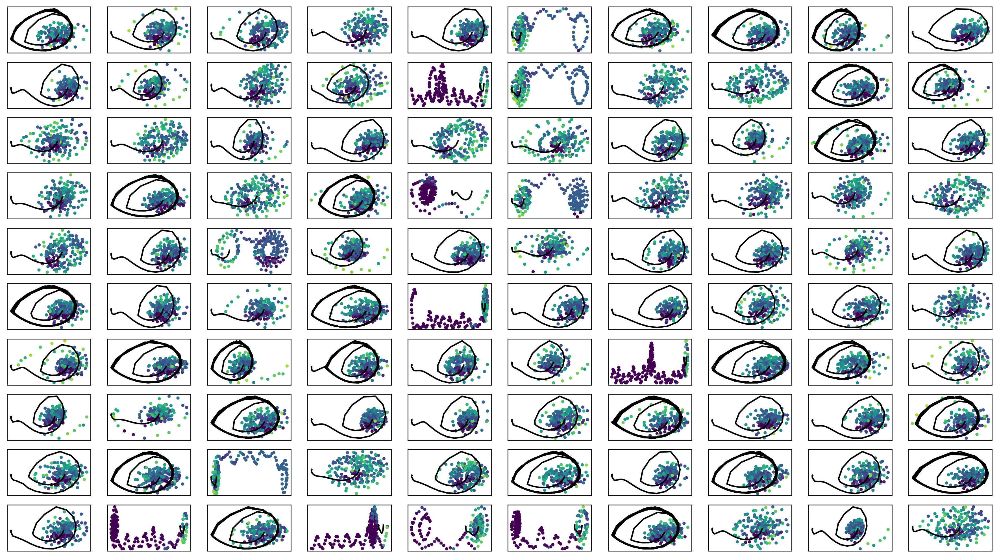

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [48]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -163.30670  validloss -69.69418±0.00000  bestvalidloss -69.69418  last_update 0
train: iter 1  trainloss -165.73866  validloss -22.93972±0.00000  bestvalidloss -69.69418  last_update 1
train: iter 2  trainloss -158.86217  validloss -93.38352±0.00000  bestvalidloss -93.38352  last_update 0
train: iter 3  trainloss -159.35012  validloss -119.16319±0.00000  bestvalidloss -119.16319  last_update 0
train: iter 4  trainloss -166.78720  validloss -131.52709±0.00000  bestvalidloss -131.52709  last_update 0
train: iter 5  trainloss -164.98071  validloss -83.79854±0.00000  bestvalidloss -131.52709  last_update 1
train: iter 6  trainloss -167.71334  validloss -126.42845±0.00000  bestvalidloss -131.52709  last_update 2
train: iter 7  trainloss -165.74935  validloss -68.49601±0.00000  bestvalidloss -131.52709  last_update 3
train: iter 8  trainloss -162.43004  validloss -58.33025±0.00000  bestvalidloss -131.52709  last_update 4
train: iter 9  tra

train: iter 76  trainloss -164.45923  validloss -49.37298±0.00000  bestvalidloss -135.62060  last_update 67
train: iter 77  trainloss -161.88508  validloss -43.81253±0.00000  bestvalidloss -135.62060  last_update 68
train: iter 78  trainloss -169.13409  validloss -78.01938±0.00000  bestvalidloss -135.62060  last_update 69
train: iter 79  trainloss -168.07901  validloss -114.69164±0.00000  bestvalidloss -135.62060  last_update 70
train: iter 80  trainloss -166.56562  validloss -99.04540±0.00000  bestvalidloss -135.62060  last_update 71
train: iter 81  trainloss -167.00756  validloss -77.45887±0.00000  bestvalidloss -135.62060  last_update 72
train: iter 82  trainloss -164.94219  validloss 6.50985±0.00000  bestvalidloss -135.62060  last_update 73
train: iter 83  trainloss -165.22574  validloss -99.14408±0.00000  bestvalidloss -135.62060  last_update 74
train: iter 84  trainloss -164.79862  validloss -92.68832±0.00000  bestvalidloss -135.62060  last_update 75
train: iter 85  trainloss -16

train: iter 153  trainloss -165.38437  validloss -56.64970±0.00000  bestvalidloss -150.72505  last_update 65
train: iter 154  trainloss -165.08072  validloss -57.31622±0.00000  bestvalidloss -150.72505  last_update 66
train: iter 155  trainloss -164.62796  validloss -81.53286±0.00000  bestvalidloss -150.72505  last_update 67
train: iter 156  trainloss -166.99591  validloss -90.93120±0.00000  bestvalidloss -150.72505  last_update 68
train: iter 157  trainloss -168.05543  validloss -96.93368±0.00000  bestvalidloss -150.72505  last_update 69
train: iter 158  trainloss -162.88089  validloss -54.46692±0.00000  bestvalidloss -150.72505  last_update 70
train: iter 159  trainloss -160.73764  validloss -124.12196±0.00000  bestvalidloss -150.72505  last_update 71
train: iter 160  trainloss -168.17384  validloss -120.56404±0.00000  bestvalidloss -150.72505  last_update 72
train: iter 161  trainloss -165.59786  validloss -106.57028±0.00000  bestvalidloss -150.72505  last_update 73
train: iter 162 

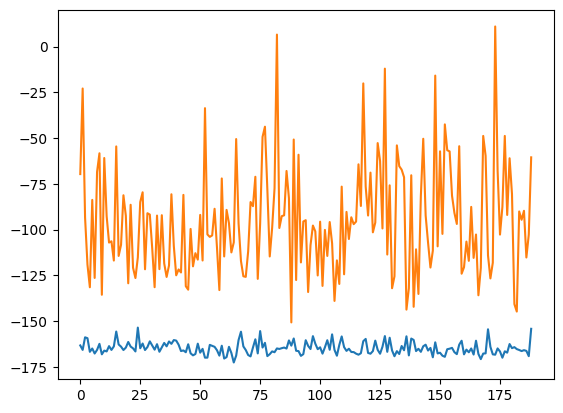

train_weighted_vae: enc
train: iter 0  trainloss -138.25770  validloss -101.20358±0.00000  bestvalidloss -101.20358  last_update 0
train: iter 1  trainloss -141.13316  validloss -95.87120±0.00000  bestvalidloss -101.20358  last_update 1
train: iter 2  trainloss -140.76620  validloss -112.36431±0.00000  bestvalidloss -112.36431  last_update 0
train: iter 3  trainloss -141.16795  validloss -112.53907±0.00000  bestvalidloss -112.53907  last_update 0
train: iter 4  trainloss -141.55183  validloss -93.34137±0.00000  bestvalidloss -112.53907  last_update 1
train: iter 5  trainloss -141.09375  validloss -108.32290±0.00000  bestvalidloss -112.53907  last_update 2
train: iter 6  trainloss -139.79982  validloss -97.11537±0.00000  bestvalidloss -112.53907  last_update 3
train: iter 7  trainloss -140.89986  validloss -97.67140±0.00000  bestvalidloss -112.53907  last_update 4
train: iter 8  trainloss -140.14989  validloss -101.23370±0.00000  bestvalidloss -112.53907  last_update 5
train: iter 9  tr

train: iter 76  trainloss -139.44899  validloss -99.87932±0.00000  bestvalidloss -133.89378  last_update 38
train: iter 77  trainloss -142.01296  validloss -77.55388±0.00000  bestvalidloss -133.89378  last_update 39
train: iter 78  trainloss -141.64162  validloss -85.94056±0.00000  bestvalidloss -133.89378  last_update 40
train: iter 79  trainloss -143.70906  validloss -107.72336±0.00000  bestvalidloss -133.89378  last_update 41
train: iter 80  trainloss -142.28479  validloss -104.91926±0.00000  bestvalidloss -133.89378  last_update 42
train: iter 81  trainloss -141.59928  validloss -97.98328±0.00000  bestvalidloss -133.89378  last_update 43
train: iter 82  trainloss -139.86962  validloss -94.16922±0.00000  bestvalidloss -133.89378  last_update 44
train: iter 83  trainloss -142.90530  validloss -109.73474±0.00000  bestvalidloss -133.89378  last_update 45
train: iter 84  trainloss -141.45847  validloss -96.48938±0.00000  bestvalidloss -133.89378  last_update 46
train: iter 85  trainloss

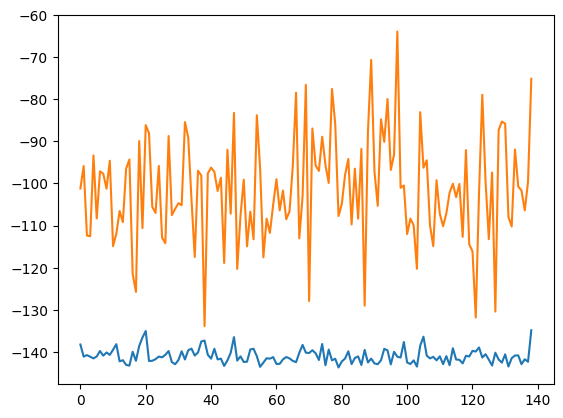

train_weighted_vae: dec
train: iter 0  trainloss -161.20005  validloss -80.24984±0.00000  bestvalidloss -80.24984  last_update 0
train: iter 1  trainloss -163.58494  validloss -123.49030±0.00000  bestvalidloss -123.49030  last_update 0
train: iter 2  trainloss -165.61262  validloss -90.76702±0.00000  bestvalidloss -123.49030  last_update 1
train: iter 3  trainloss -165.60194  validloss -112.39254±0.00000  bestvalidloss -123.49030  last_update 2
train: iter 4  trainloss -166.10316  validloss -118.87915±0.00000  bestvalidloss -123.49030  last_update 3
train: iter 5  trainloss -166.79658  validloss -107.05848±0.00000  bestvalidloss -123.49030  last_update 4
train: iter 6  trainloss -162.86288  validloss -77.99690±0.00000  bestvalidloss -123.49030  last_update 5
train: iter 7  trainloss -166.58374  validloss -112.41303±0.00000  bestvalidloss -123.49030  last_update 6
train: iter 8  trainloss -166.83324  validloss -97.25424±0.00000  bestvalidloss -123.49030  last_update 7
train: iter 9  tra

train: iter 76  trainloss -160.82345  validloss -71.54213±0.00000  bestvalidloss -123.49030  last_update 75
train: iter 77  trainloss -168.15628  validloss -76.17717±0.00000  bestvalidloss -123.49030  last_update 76
train: iter 78  trainloss -166.99227  validloss -70.47175±0.00000  bestvalidloss -123.49030  last_update 77
train: iter 79  trainloss -166.33846  validloss -69.80601±0.00000  bestvalidloss -123.49030  last_update 78
train: iter 80  trainloss -168.74979  validloss -58.97935±0.00000  bestvalidloss -123.49030  last_update 79
train: iter 81  trainloss -166.07718  validloss -81.26890±0.00000  bestvalidloss -123.49030  last_update 80
train: iter 82  trainloss -167.82846  validloss -77.03472±0.00000  bestvalidloss -123.49030  last_update 81
train: iter 83  trainloss -165.94898  validloss -89.22067±0.00000  bestvalidloss -123.49030  last_update 82
train: iter 84  trainloss -169.37748  validloss -54.79070±0.00000  bestvalidloss -123.49030  last_update 83
train: iter 85  trainloss -1

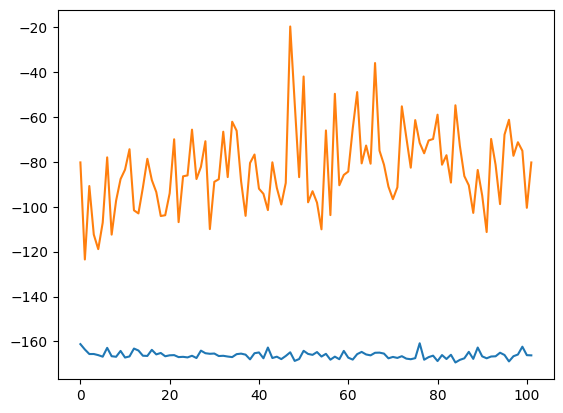

alpha 0.3 vae_lr 0.0005


In [49]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.09148385821339329
1  c = 0.19677822148600232
2  c = 0.2273337713615298
3  c = 0.0792087102897038
4  c = 0.20555015683793504
5  c = 0.19176888264455483
6  c = 0.18267177166236348
7  c = 0.24402681472422738
8  c = 0.29423821451915294
9  c = 0.023790697391420857
10  c = 0.2020342306054244
11  c = 0.20684945695371632
12  c = 0.02913033904059362
13  c = 0.2978413218792869
14  c = 0.2747758512269614
15  c = 0.006994386212546632
16  c = 0.03535076766836032
17  c = 0.13544357115059946
18  c = 0.18210899671614134
19  c = 0.13599612539277364
20  c = 0.1247768865398707
21  c = 0.23814998276729366
22  c = 0.015975780921363047
23  c = 0.09585999466227044
24  c = 0.052946875921209564
25  c = 0.2663765731372429
26  c = 0.019230877798626898
27  c = 0.16076296690239142
28  c = 0.11395892260656697
29  c = 0.14109895294644367
30  c = 0.04506000808804537
31  c = 0.19249165795189413
32  c = 0.1524980033145635
33  c = 0.019390904569831568
34  c = 0.17628406257221338
35  c = 0.12850286406606606
36  

96  c = 0.02314663660989902
97  c = 0.2874548115021382
98  c = 0.05520951816998426
99  c = 0.1600013164038132
 
実環境方策rollout vs Sim環境方策rollout


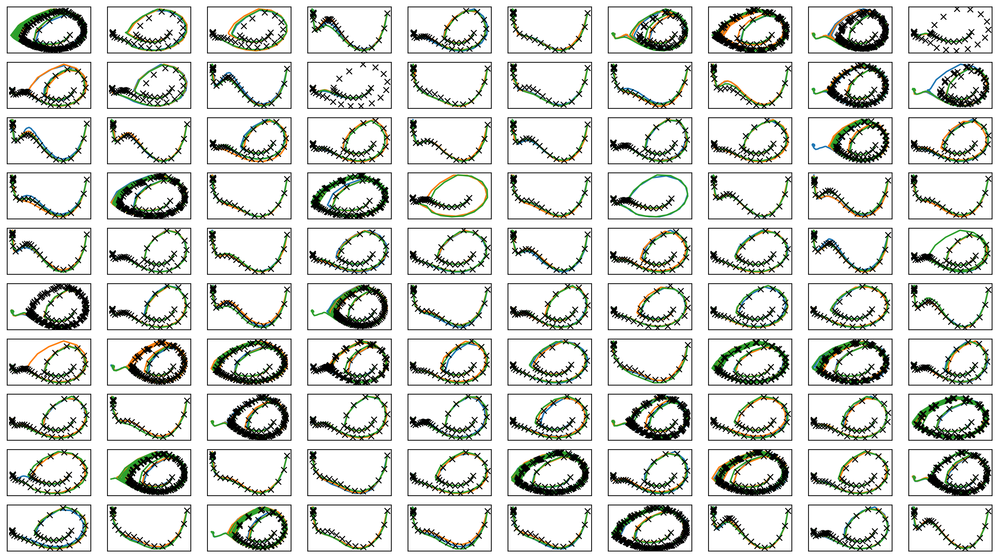

In [50]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
plt.savefig(figfilenamehead+"joint_iter4.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

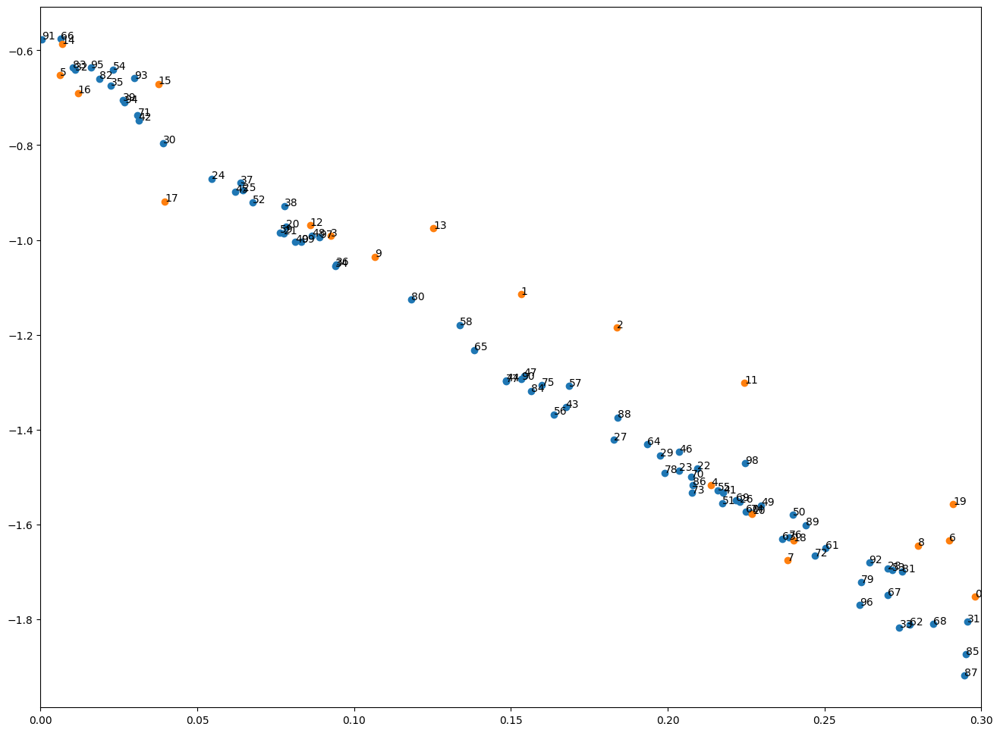

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [51]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
plt.savefig(figfilenamehead+"damping_latent_iter4.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [52]:
print(datetime.datetime.now())

2023-03-29 22:21:08.506387


# Iter5

In [53]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.02086387098206499
c = 0.010841425089774991
c = 0.19952530784024688
c = 0.13236779507673982
c = 0.027383800804752046
c = 0.14859421135292844
c = 0.008492157920843079
c = 0.06272295209971333
c = 0.06320585566195969
c = 0.09557938217925227
1  c = 0.05355934967882665
c = 0.25272044250494147
c = 0.10495840319545593
c = 0.15041436943832429
c = 0.21583365041233932
c = 0.04835363212909542
c = 0.13361158844159823
c = 0.19696429710976768
c = 0.0440683099094029
2  c = 0.18516227389484946
c = 0.016589603945366516
c = 0.08019316480839411
c = 0.15594445693933306
c = 0.01091022441269056
c = 0.0982906633429967
c = 0.12127372931560455
3  c = 0.15066683174515602
c = 0.12940211359665266
c = 0.005909638108446791
c = 0.1842423727004404
c = 0.14986092567860695
c = 0.08783565319428578
c = 0.13180667849292102
c = 0.1596390141406685
4  c = 0.13768198008353655
c = 0.24777067313955703
c = 0.17363351075424804
c = 0.008048397716354882
c = 0.16908084956331082
c = 0.1618174444593938
c = 0.26228129500680486


c = 0.03280545320881882
c = 0.09632354297690514
39  c = 0.269953842749464
c = 0.04033404150413065
c = 0.15821912013972741
c = 0.08641963761057107
c = 0.13851721483558074
c = 0.2475939017036386
c = 0.267436619608427
40  c = 0.14341513800415973
c = 0.2710748764864809
c = 0.031465914791562695
c = 0.20796462526146656
c = 0.06648608115111661
c = 0.15542868300508286
c = 0.23758423721468513
41  c = 0.1052409433250557
c = 0.08104611892500675
c = 0.17610091424193391
c = 0.29012332260432483
c = 0.2577968403583737
c = 0.014194820703049081
42  c = 0.2587599288969001
c = 0.2537616430690584
c = 0.06507518026106124
c = 0.056421706479945766
c = 0.037207994124354146
c = 0.23166334701344585
c = 0.10169173922102016
c = 0.27272397959300737
c = 0.08015461345560763
c = 0.044365762800049564
43  c = 0.14657773533857332
c = 0.141644762505809
c = 0.2505782142276811
c = 0.25547140206991664
44  c = 0.14237146220549493
c = 0.05175016618622181
c = 0.10856662734564877
c = 0.23216175843895445
c = 0.11680502335282605


c = 0.06766094903759702
c = 0.10367971020407628
c = 0.059909812565362014
82  c = 0.010517973113360378
c = 0.20825082061847874
c = 0.22777840390455306
c = 0.20477909024649418
c = 0.17134435558594963
c = 0.1281793671623723
c = 0.29976425936496703
c = 0.2092049156631375
c = 0.16872948976529045
c = 0.08646509200145648
c = 0.17251462247690771
c = 0.09637075696810038
83  c = 0.09755674105449393
c = 0.27538558871246066
c = 0.130644685277917
c = 0.2844779079305362
c = 0.18927005119838367
c = 0.24603443927635196
c = 0.24666374748543185
c = 0.019521535646287013
c = 0.034351991196242236
84  c = 0.04651426466498419
c = 0.2542805006845653
c = 0.013527858392407976
c = 0.16013105984167406
c = 0.16617168850058772
c = 0.25217207290676963
c = 0.021301693778758134
c = 0.07172914782326507
c = 0.0446228854644433
c = 0.06601682859531419
c = 0.07582324685686527
c = 0.13772334898156385
c = 0.05463929731200732
c = 0.06587693731537393
85  c = 0.27786793184400005
c = 0.25064498007932473
c = 0.2635073154043643
c 

In [54]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.11768  validloss 0.13881±0.00000  bestvalidloss 0.13881  last_update 0
train: iter 1  trainloss 0.11643  validloss 0.14019±0.00000  bestvalidloss 0.13881  last_update 1
train: iter 2  trainloss 0.11905  validloss 0.13671±0.00000  bestvalidloss 0.13671  last_update 0
train: iter 3  trainloss 0.11618  validloss 0.13864±0.00000  bestvalidloss 0.13671  last_update 1
train: iter 4  trainloss 0.11745  validloss 0.13534±0.00000  bestvalidloss 0.13534  last_update 0
train: iter 5  trainloss 0.11623  validloss 0.14092±0.00000  bestvalidloss 0.13534  last_update 1
train: iter 6  trainloss 0.11607  validloss 0.13945±0.00000  bestvalidloss 0.13534  last_update 2
train: iter 7  trainloss 0.11666  validloss 0.14118±0.00000  bestvalidloss 0.13534  last_update 3
train: iter 8  trainloss 0.11530  validloss 0.13981±0.00000  bestvalidloss 0.13534  last_update 4
train: iter 9  trainloss 0.11477  validloss 0.13702±0.00000  bestvalidloss 0.13534  last_update 5
train: iter 10  trai

train: iter 85  trainloss 0.11226  validloss 0.14101±0.00000  bestvalidloss 0.13534  last_update 81
train: iter 86  trainloss 0.11219  validloss 0.14217±0.00000  bestvalidloss 0.13534  last_update 82
train: iter 87  trainloss 0.11443  validloss 0.14126±0.00000  bestvalidloss 0.13534  last_update 83
train: iter 88  trainloss 0.11448  validloss 0.14360±0.00000  bestvalidloss 0.13534  last_update 84
train: iter 89  trainloss 0.11294  validloss 0.13935±0.00000  bestvalidloss 0.13534  last_update 85
train: iter 90  trainloss 0.11358  validloss 0.14257±0.00000  bestvalidloss 0.13534  last_update 86
train: iter 91  trainloss 0.11281  validloss 0.13988±0.00000  bestvalidloss 0.13534  last_update 87
train: iter 92  trainloss 0.11293  validloss 0.13919±0.00000  bestvalidloss 0.13534  last_update 88
train: iter 93  trainloss 0.11266  validloss 0.14397±0.00000  bestvalidloss 0.13534  last_update 89
train: iter 94  trainloss 0.11242  validloss 0.14218±0.00000  bestvalidloss 0.13534  last_update 90


In [55]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -163.38778779387474
valid_loss:  -27.616802556514738
train_loss:  -131.81107746362687
valid_loss:  -54.160278244018556


1e-08 1000.0


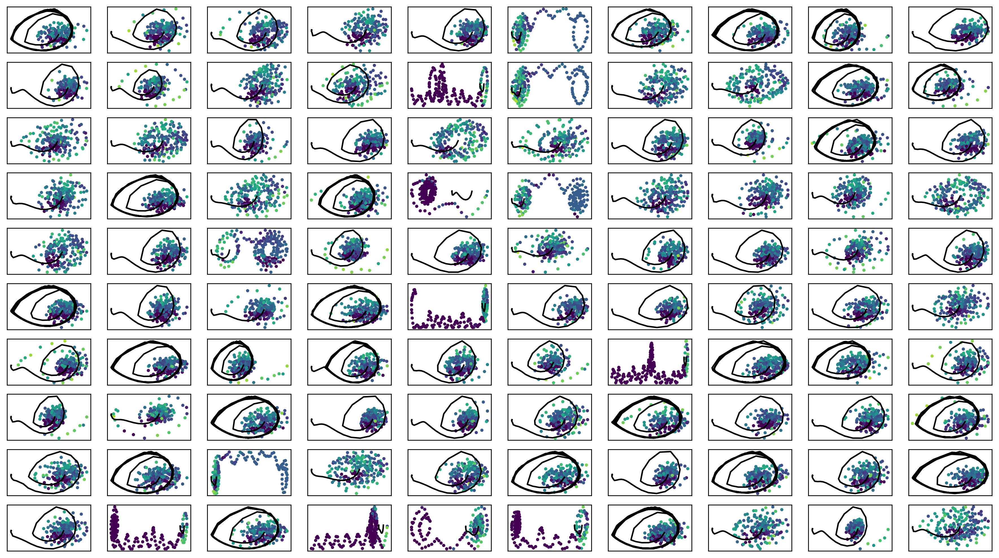

In [56]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [57]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [58]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -126.50319  validloss -54.89344±0.00000  bestvalidloss -54.89344  last_update 0
train: iter 1  trainloss -131.02391  validloss -54.40043±0.00000  bestvalidloss -54.89344  last_update 1
train: iter 2  trainloss -131.45709  validloss -83.92032±0.00000  bestvalidloss -83.92032  last_update 0
train: iter 3  trainloss -130.27213  validloss -82.69146±0.00000  bestvalidloss -83.92032  last_update 1
train: iter 4  trainloss -117.70197  validloss -77.98014±0.00000  bestvalidloss -83.92032  last_update 2
train: iter 5  trainloss -128.05695  validloss -91.64938±0.00000  bestvalidloss -91.64938  last_update 0
train: iter 6  trainloss -130.82993  validloss -67.27276±0.00000  bestvalidloss -91.64938  last_update 1
train: iter 7  trainloss -128.83448  validloss -90.04642±0.00000  bestvalidloss -91.64938  last_update 2
train: iter 8  trainloss -127.77261  validloss -84.46782±0.00000  bestvalidloss -91.64938  last_update 3
train: iter 9  trainloss -1

train: iter 77  trainloss -128.91531  validloss -97.85265±0.00000  bestvalidloss -116.26196  last_update 17
train: iter 78  trainloss -129.60162  validloss -63.54333±0.00000  bestvalidloss -116.26196  last_update 18
train: iter 79  trainloss -129.79847  validloss -96.29826±0.00000  bestvalidloss -116.26196  last_update 19
train: iter 80  trainloss -129.66353  validloss -71.85867±0.00000  bestvalidloss -116.26196  last_update 20
train: iter 81  trainloss -126.98401  validloss -79.53901±0.00000  bestvalidloss -116.26196  last_update 21
train: iter 82  trainloss -130.55228  validloss -69.46039±0.00000  bestvalidloss -116.26196  last_update 22
train: iter 83  trainloss -128.71106  validloss -76.81602±0.00000  bestvalidloss -116.26196  last_update 23
train: iter 84  trainloss -126.82687  validloss -65.55221±0.00000  bestvalidloss -116.26196  last_update 24
train: iter 85  trainloss -125.64482  validloss -42.91312±0.00000  bestvalidloss -116.26196  last_update 25
train: iter 86  trainloss -1

train: iter 155  trainloss -128.28363  validloss -92.88189±0.00000  bestvalidloss -116.26196  last_update 95
train: iter 156  trainloss -129.44344  validloss -64.20681±0.00000  bestvalidloss -116.26196  last_update 96
train: iter 157  trainloss -125.95892  validloss -60.78330±0.00000  bestvalidloss -116.26196  last_update 97
train: iter 158  trainloss -130.35995  validloss -67.79741±0.00000  bestvalidloss -116.26196  last_update 98
train: iter 159  trainloss -128.54195  validloss -94.88298±0.00000  bestvalidloss -116.26196  last_update 99
train: iter 160  trainloss -124.82740  validloss -17.80341±0.00000  bestvalidloss -116.26196  last_update 100
train: fin


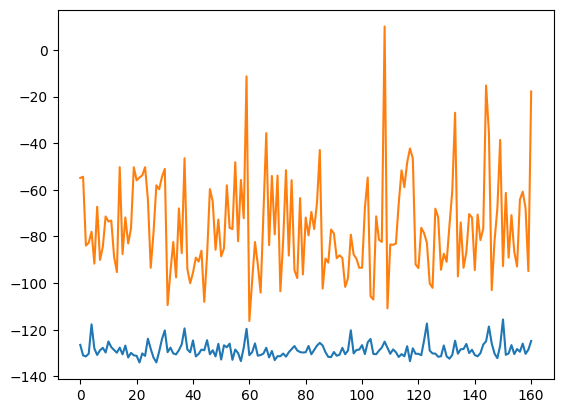

train_weighted_vae: enc
train: iter 0  trainloss -129.93281  validloss -95.77909±0.00000  bestvalidloss -95.77909  last_update 0
train: iter 1  trainloss -131.04182  validloss -76.66421±0.00000  bestvalidloss -95.77909  last_update 1
train: iter 2  trainloss -131.51263  validloss -97.84827±0.00000  bestvalidloss -97.84827  last_update 0
train: iter 3  trainloss -129.13377  validloss -90.62766±0.00000  bestvalidloss -97.84827  last_update 1
train: iter 4  trainloss -129.35921  validloss -85.83120±0.00000  bestvalidloss -97.84827  last_update 2
train: iter 5  trainloss -130.94368  validloss -88.35629±0.00000  bestvalidloss -97.84827  last_update 3
train: iter 6  trainloss -132.78747  validloss -101.66475±0.00000  bestvalidloss -101.66475  last_update 0
train: iter 7  trainloss -130.51755  validloss -77.36301±0.00000  bestvalidloss -101.66475  last_update 1
train: iter 8  trainloss -131.86865  validloss -88.54307±0.00000  bestvalidloss -101.66475  last_update 2
train: iter 9  trainloss -1

train: iter 76  trainloss -130.97982  validloss -87.26211±0.00000  bestvalidloss -116.10914  last_update 4
train: iter 77  trainloss -132.25717  validloss -101.98202±0.00000  bestvalidloss -116.10914  last_update 5
train: iter 78  trainloss -125.92413  validloss -113.13937±0.00000  bestvalidloss -116.10914  last_update 6
train: iter 79  trainloss -123.71880  validloss -35.06313±0.00000  bestvalidloss -116.10914  last_update 7
train: iter 80  trainloss -129.55757  validloss -105.49598±0.00000  bestvalidloss -116.10914  last_update 8
train: iter 81  trainloss -131.81498  validloss -113.96015±0.00000  bestvalidloss -116.10914  last_update 9
train: iter 82  trainloss -131.79382  validloss -119.01952±0.00000  bestvalidloss -119.01952  last_update 0
train: iter 83  trainloss -131.27940  validloss -108.30788±0.00000  bestvalidloss -119.01952  last_update 1
train: iter 84  trainloss -132.33094  validloss -99.89074±0.00000  bestvalidloss -119.01952  last_update 2
train: iter 85  trainloss -130.

train: iter 153  trainloss -130.56365  validloss -107.32071±0.00000  bestvalidloss -119.01952  last_update 71
train: iter 154  trainloss -133.19690  validloss -79.62073±0.00000  bestvalidloss -119.01952  last_update 72
train: iter 155  trainloss -131.95593  validloss -86.06457±0.00000  bestvalidloss -119.01952  last_update 73
train: iter 156  trainloss -131.67341  validloss -93.12665±0.00000  bestvalidloss -119.01952  last_update 74
train: iter 157  trainloss -131.27903  validloss -105.73137±0.00000  bestvalidloss -119.01952  last_update 75
train: iter 158  trainloss -131.88608  validloss -91.25740±0.00000  bestvalidloss -119.01952  last_update 76
train: iter 159  trainloss -132.04680  validloss -93.54068±0.00000  bestvalidloss -119.01952  last_update 77
train: iter 160  trainloss -129.90413  validloss -88.06945±0.00000  bestvalidloss -119.01952  last_update 78
train: iter 161  trainloss -132.44911  validloss -96.02915±0.00000  bestvalidloss -119.01952  last_update 79
train: iter 162  

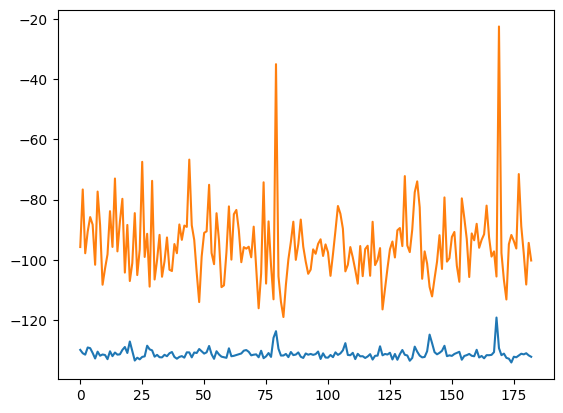

train_weighted_vae: dec
train: iter 0  trainloss -131.38598  validloss -88.83988±0.00000  bestvalidloss -88.83988  last_update 0
train: iter 1  trainloss -130.45863  validloss -81.18170±0.00000  bestvalidloss -88.83988  last_update 1
train: iter 2  trainloss -133.20006  validloss -64.90704±0.00000  bestvalidloss -88.83988  last_update 2
train: iter 3  trainloss -129.20110  validloss -62.66099±0.00000  bestvalidloss -88.83988  last_update 3
train: iter 4  trainloss -129.29450  validloss -63.61923±0.00000  bestvalidloss -88.83988  last_update 4
train: iter 5  trainloss -131.83984  validloss -58.65746±0.00000  bestvalidloss -88.83988  last_update 5
train: iter 6  trainloss -129.75838  validloss -46.18755±0.00000  bestvalidloss -88.83988  last_update 6
train: iter 7  trainloss -129.91142  validloss -65.58924±0.00000  bestvalidloss -88.83988  last_update 7
train: iter 8  trainloss -129.84354  validloss -70.26379±0.00000  bestvalidloss -88.83988  last_update 8
train: iter 9  trainloss -131.6

train: iter 77  trainloss -129.80414  validloss -48.95723±0.00000  bestvalidloss -88.83988  last_update 77
train: iter 78  trainloss -132.61908  validloss -67.52845±0.00000  bestvalidloss -88.83988  last_update 78
train: iter 79  trainloss -131.67176  validloss -67.88778±0.00000  bestvalidloss -88.83988  last_update 79
train: iter 80  trainloss -131.39417  validloss -26.22397±0.00000  bestvalidloss -88.83988  last_update 80
train: iter 81  trainloss -130.62005  validloss -69.18312±0.00000  bestvalidloss -88.83988  last_update 81
train: iter 82  trainloss -130.78160  validloss -19.27013±0.00000  bestvalidloss -88.83988  last_update 82
train: iter 83  trainloss -131.00477  validloss 1.93457±0.00000  bestvalidloss -88.83988  last_update 83
train: iter 84  trainloss -130.67524  validloss -74.30168±0.00000  bestvalidloss -88.83988  last_update 84
train: iter 85  trainloss -130.69135  validloss -54.19789±0.00000  bestvalidloss -88.83988  last_update 85
train: iter 86  trainloss -127.13160  v

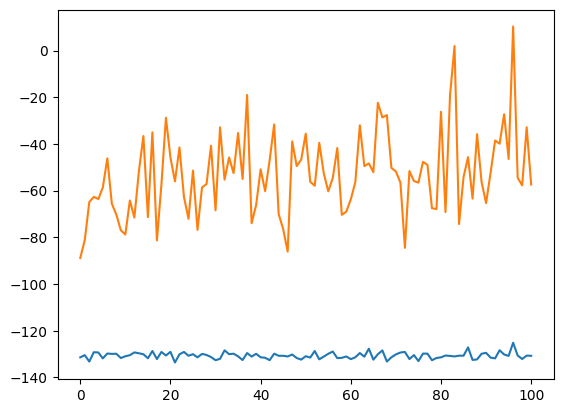

alpha 0.3 vae_lr 0.0005


In [59]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  c = 0.04431516984872743
1  c = 0.10874927172983001
2  c = 0.21685009479950498
3  c = 0.11434808139118496
4  c = 0.19207418560607595
5  c = 0.0027267896249776103
6  c = 0.08084131396785284
7  c = 0.17566554457815667
8  c = 0.04892792937525887
9  c = 0.02855364593235461
10  c = 0.057193687323415794
11  c = 0.1453220577465025
12  c = 0.24622010383455115
13  c = 0.004289638385519501
14  c = 0.18085585989094402
15  c = 0.2755911585973103
16  c = 0.09562927521152759
17  c = 0.20294890816553027
18  c = 0.1014635702292359
19  c = 0.2116287567127008
20  c = 0.2060594942312159
21  c = 0.2854798523937928
22  c = 0.05596825765204788
23  c = 0.014738224621019112
24  c = 0.08058004729867632
25  c = 0.028079292696132897
26  c = 0.13635539512374065
27  c = 0.13575420538107172
28  c = 0.04618397146287257
29  c = 0.23169298841797006
30  c = 0.1468505863544505
31  c = 0.07499828532381753
32  c = 0.294809867186907
33  c = 0.03308870423444743
34  c = 0.23512460846050545
35  c = 0.04858226493017169
36  c

97  c = 0.008475925701318365
98  c = 0.2691039603928158
99  c = 0.2875387588174908
 
実環境方策rollout vs Sim環境方策rollout


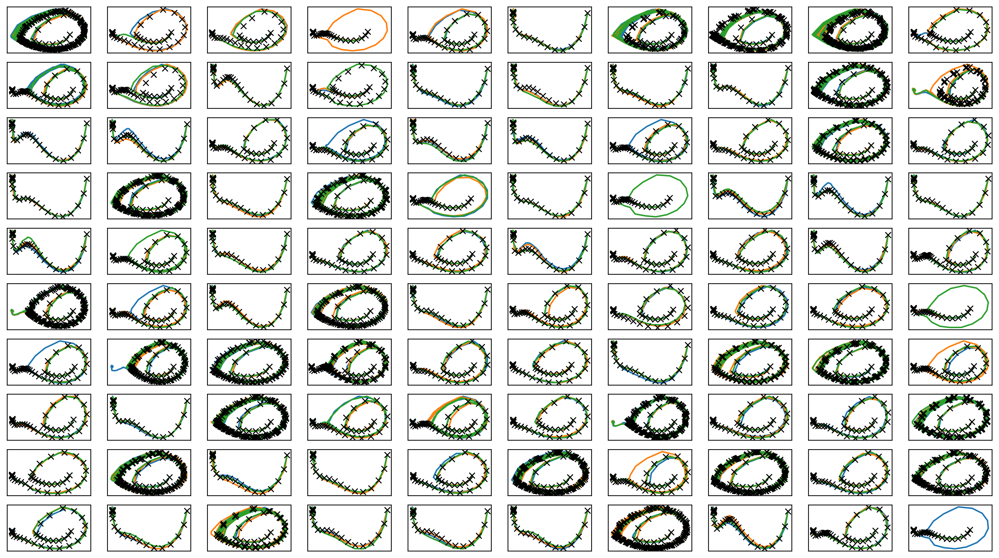

In [60]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
plt.savefig(figfilenamehead+"joint_iter5.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

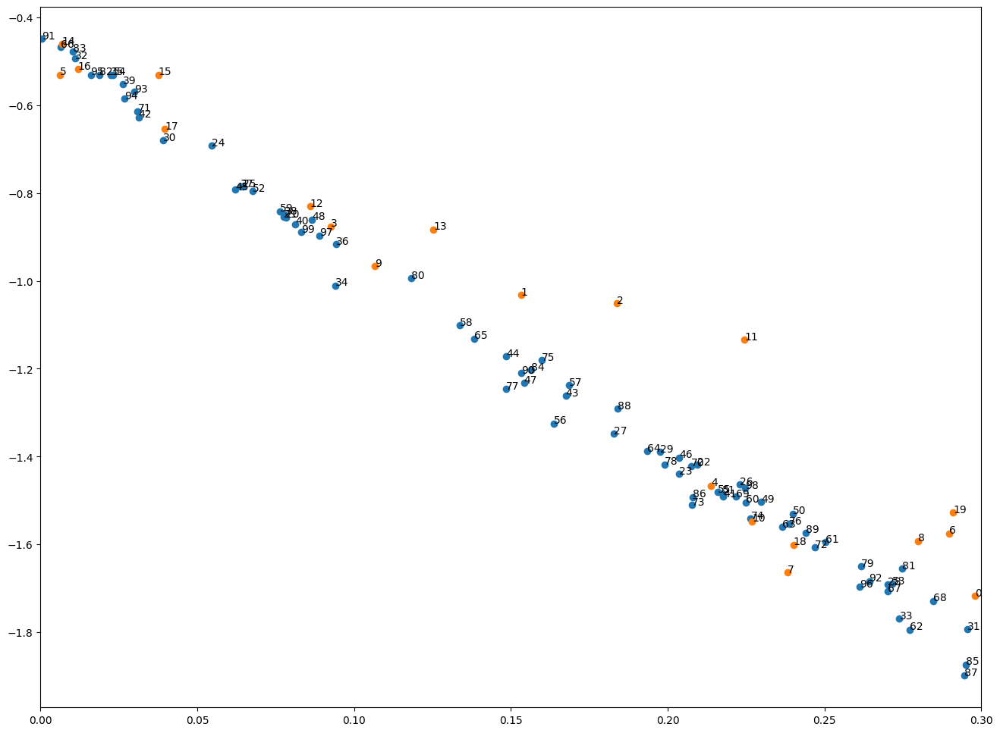

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
plt.savefig(figfilenamehead+"damping_latent_iter5.pdf")

plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-03-29 22:23:04.217541


# 評価関数計算

In [63]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  c = 0.057530368951230454
c = 0.12786648047122678
c = 0.10691667951159768
c = 0.045502322717939005
c = 0.10682224675591317
c = 0.2875710153960633
c = 0.16864951138662324
c = 0.05744351993381869
c = 0.023253553079672685
c = 0.28779542040917905
1  c = 0.14155072192217943
c = 0.07993687542695642
c = 0.24592709336035884
c = 0.008887647494890337
c = 0.06442433967763651
c = 0.17058263275753857
c = 0.08767514861655869
c = 0.29629215506595197
c = 0.28881875617122715
c = 0.0522162376293258
2  c = 0.03950575663061277
c = 0.13694020238176002
c = 0.19760450351027675
c = 0.2905728262984227
c = 0.1650823544062542
c = 0.2679641124681452
c = 0.01830248096460737
c = 0.016947378652839493
c = 0.23502338437641374
c = 0.18294199633673203
c = 0.060061558392056874
3  c = 0.2855461948951609
c = 0.2160885043888056
c = 0.17445894451405608
c = 0.2083755806907642
c = 0.058697910356699495
c = 0.2176626430183115
c = 0.2708622529635024
c = 0.060365487776253196
c = 0.2542419659312831
c = 0.2355636047057502
4  c = 0

c = 0.1610854069155233
c = 0.14554448658012112
36  c = 0.14302928197850076
c = 0.18209723201578082
c = 0.22662326575881106
c = 0.11970277008134461
c = 0.1847911734416688
c = 0.22388855841604552
c = 0.08829320291287422
c = 0.10122357974346066
37  c = 0.0985350974099181
c = 0.1024669130023008
c = 0.0011884610174187293
c = 0.07647126980624276
c = 0.05051982071004398
c = 0.06645044648938307
c = 0.2084197340273864
c = 0.24400293900462683
c = 0.2675403313161017
c = 0.28358192401409016
38  c = 0.05700830692546951
c = 0.19563668246424798
c = 0.2837759715895195
c = 0.0692614461420218
c = 0.2762774031526268
c = 0.2687435575460893
c = 0.14963951571892456
c = 0.13023395338659957
c = 0.042525987009671605
39  c = 0.21105262762016266
c = 0.1313262163130439
c = 0.11253843346931965
c = 0.023777195252672023
c = 0.02918953826509424
c = 0.03313632006610634
c = 0.26377071269804975
c = 0.1295850628841528
40  c = 0.0701982365281323
c = 0.04143904821998856
c = 0.2808229651159681
c = 0.028294918015714154
c = 0

c = 0.13814422814729088
c = 0.0881140464878345
c = 0.14049271716156136
c = 0.27255125293785776
c = 0.23840948196888317
c = 0.21742723038047193
74  c = 0.13837226098013797
c = 0.1244571267501538
c = 0.11838146391583117
c = 0.05326159728997931
c = 0.09742508251669194
c = 0.192763958344266
c = 0.08214901076758566
c = 0.21836170958918646
c = 0.1959375474184201
c = 0.2693390457414262
c = 0.014647396210614816
c = 0.12412823739328056
c = 0.25180037438000824
c = 0.13229236288659277
c = 0.08649488436978682
75  c = 0.07477537881234195
c = 0.29705475135759934
c = 0.025769058572540936
c = 0.2653841061277332
c = 0.013669890310833377
76  c = 0.09633685684410202
c = 0.1763368264860363
c = 0.2927065563293984
c = 0.16108978731510798
c = 0.07088148354134818
c = 0.09398669491170272
c = 0.04567670616124185
c = 0.20545302677025312
c = 0.22166554406358752
c = 0.1522765803943546
c = 0.1634952750502924
c = 0.04661067033107664
c = 0.29028891718953237
c = 0.2831838417714458
c = 0.22228440820976256
c = 0.2055229

In [64]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.13032  validloss 0.16809±0.00000  bestvalidloss 0.16809  last_update 0
train: iter 1  trainloss 0.12827  validloss 0.16090±0.00000  bestvalidloss 0.16090  last_update 0
train: iter 2  trainloss 0.12728  validloss 0.16139±0.00000  bestvalidloss 0.16090  last_update 1
train: iter 3  trainloss 0.12635  validloss 0.16157±0.00000  bestvalidloss 0.16090  last_update 2
train: iter 4  trainloss 0.12668  validloss 0.16202±0.00000  bestvalidloss 0.16090  last_update 3
train: iter 5  trainloss 0.12701  validloss 0.16202±0.00000  bestvalidloss 0.16090  last_update 4
train: iter 6  trainloss 0.12695  validloss 0.16071±0.00000  bestvalidloss 0.16071  last_update 0
train: iter 7  trainloss 0.12721  validloss 0.16022±0.00000  bestvalidloss 0.16022  last_update 0
train: iter 8  trainloss 0.12730  validloss 0.15922±0.00000  bestvalidloss 0.15922  last_update 0
train: iter 9  trainloss 0.12566  validloss 0.16230±0.00000  bestvalidloss 0.15922  last_update 1
train: iter 10  trai

train: iter 83  trainloss 0.12327  validloss 0.15965±0.00000  bestvalidloss 0.15664  last_update 1
train: iter 84  trainloss 0.12501  validloss 0.15956±0.00000  bestvalidloss 0.15664  last_update 2
train: iter 85  trainloss 0.12344  validloss 0.16321±0.00000  bestvalidloss 0.15664  last_update 3
train: iter 86  trainloss 0.12415  validloss 0.15901±0.00000  bestvalidloss 0.15664  last_update 4
train: iter 87  trainloss 0.12337  validloss 0.15982±0.00000  bestvalidloss 0.15664  last_update 5
train: iter 88  trainloss 0.12522  validloss 0.15929±0.00000  bestvalidloss 0.15664  last_update 6
train: iter 89  trainloss 0.12407  validloss 0.16129±0.00000  bestvalidloss 0.15664  last_update 7
train: iter 90  trainloss 0.12384  validloss 0.16111±0.00000  bestvalidloss 0.15664  last_update 8
train: iter 91  trainloss 0.12603  validloss 0.15842±0.00000  bestvalidloss 0.15664  last_update 9
train: iter 92  trainloss 0.12385  validloss 0.15807±0.00000  bestvalidloss 0.15664  last_update 10
train: it

train: iter 165  trainloss 0.12189  validloss 0.15964±0.00000  bestvalidloss 0.15635  last_update 16
train: iter 166  trainloss 0.12443  validloss 0.15856±0.00000  bestvalidloss 0.15635  last_update 17
train: iter 167  trainloss 0.12203  validloss 0.15758±0.00000  bestvalidloss 0.15635  last_update 18
train: iter 168  trainloss 0.12266  validloss 0.15767±0.00000  bestvalidloss 0.15635  last_update 19
train: iter 169  trainloss 0.12275  validloss 0.15729±0.00000  bestvalidloss 0.15635  last_update 20
train: iter 170  trainloss 0.12211  validloss 0.15876±0.00000  bestvalidloss 0.15635  last_update 21
train: iter 171  trainloss 0.12335  validloss 0.15906±0.00000  bestvalidloss 0.15635  last_update 22
train: iter 172  trainloss 0.12291  validloss 0.16154±0.00000  bestvalidloss 0.15635  last_update 23
train: iter 173  trainloss 0.12130  validloss 0.15737±0.00000  bestvalidloss 0.15635  last_update 24
train: iter 174  trainloss 0.12144  validloss 0.15803±0.00000  bestvalidloss 0.15635  last_

train: iter 248  trainloss 0.12162  validloss 0.15744±0.00000  bestvalidloss 0.15610  last_update 16
train: iter 249  trainloss 0.12310  validloss 0.15878±0.00000  bestvalidloss 0.15610  last_update 17
train: iter 250  trainloss 0.12461  validloss 0.16045±0.00000  bestvalidloss 0.15610  last_update 18
train: iter 251  trainloss 0.12136  validloss 0.15702±0.00000  bestvalidloss 0.15610  last_update 19
train: iter 252  trainloss 0.12183  validloss 0.16199±0.00000  bestvalidloss 0.15610  last_update 20
train: iter 253  trainloss 0.12090  validloss 0.15889±0.00000  bestvalidloss 0.15610  last_update 21
train: iter 254  trainloss 0.12147  validloss 0.16026±0.00000  bestvalidloss 0.15610  last_update 22
train: iter 255  trainloss 0.12155  validloss 0.16012±0.00000  bestvalidloss 0.15610  last_update 23
train: iter 256  trainloss 0.12075  validloss 0.15722±0.00000  bestvalidloss 0.15610  last_update 24
train: iter 257  trainloss 0.12565  validloss 0.15690±0.00000  bestvalidloss 0.15610  last_

In [65]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -179.92428196966648
valid_loss:  -37.28003748893738
train_loss:  -153.81979037523269
valid_loss:  -76.63803490877152


In [66]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=100)


train: iter 0  trainloss 7.90403  validloss 8.90744±0.00000  bestvalidloss 8.90744  last_update 0
train: iter 1  trainloss 7.05809  validloss 7.94387±0.00000  bestvalidloss 7.94387  last_update 0
train: iter 2  trainloss 6.35165  validloss 7.10728±0.00000  bestvalidloss 7.10728  last_update 0
train: iter 3  trainloss 5.74219  validloss 6.38725±0.00000  bestvalidloss 6.38725  last_update 0
train: iter 4  trainloss 5.22134  validloss 5.82441±0.00000  bestvalidloss 5.82441  last_update 0
train: iter 5  trainloss 4.78975  validloss 5.31627±0.00000  bestvalidloss 5.31627  last_update 0
train: iter 6  trainloss 4.41402  validloss 4.87932±0.00000  bestvalidloss 4.87932  last_update 0
train: iter 7  trainloss 4.07754  validloss 4.52961±0.00000  bestvalidloss 4.52961  last_update 0
train: iter 8  trainloss 3.79732  validloss 4.18970±0.00000  bestvalidloss 4.18970  last_update 0
train: iter 9  trainloss 3.55715  validloss 3.92207±0.00000  bestvalidloss 3.92207  last_update 0
train: iter 10  trai

train: iter 95  trainloss 0.54556  validloss 0.60246±0.00000  bestvalidloss 0.58545  last_update 5
train: iter 96  trainloss 0.55289  validloss 0.59982±0.00000  bestvalidloss 0.58545  last_update 6
train: iter 97  trainloss 0.55782  validloss 0.59556±0.00000  bestvalidloss 0.58545  last_update 7
train: iter 98  trainloss 0.56041  validloss 0.60860±0.00000  bestvalidloss 0.58545  last_update 8
train: iter 99  trainloss 0.55089  validloss 0.59236±0.00000  bestvalidloss 0.58545  last_update 9
train: iter 100  trainloss 0.56107  validloss 0.60956±0.00000  bestvalidloss 0.58545  last_update 10
train: iter 101  trainloss 0.55388  validloss 0.59904±0.00000  bestvalidloss 0.58545  last_update 11
train: iter 102  trainloss 0.56414  validloss 0.59891±0.00000  bestvalidloss 0.58545  last_update 12
train: iter 103  trainloss 0.55744  validloss 0.57532±0.00000  bestvalidloss 0.57532  last_update 0
train: iter 104  trainloss 0.54857  validloss 0.60307±0.00000  bestvalidloss 0.57532  last_update 1
tr

train: iter 178  trainloss 0.54988  validloss 0.59651±0.00000  bestvalidloss 0.56350  last_update 40
train: iter 179  trainloss 0.53489  validloss 0.60252±0.00000  bestvalidloss 0.56350  last_update 41
train: iter 180  trainloss 0.54507  validloss 0.61669±0.00000  bestvalidloss 0.56350  last_update 42
train: iter 181  trainloss 0.54350  validloss 0.59585±0.00000  bestvalidloss 0.56350  last_update 43
train: iter 182  trainloss 0.55259  validloss 0.57307±0.00000  bestvalidloss 0.56350  last_update 44
train: iter 183  trainloss 0.55264  validloss 0.59459±0.00000  bestvalidloss 0.56350  last_update 45
train: iter 184  trainloss 0.54987  validloss 0.61346±0.00000  bestvalidloss 0.56350  last_update 46
train: iter 185  trainloss 0.55334  validloss 0.58646±0.00000  bestvalidloss 0.56350  last_update 47
train: iter 186  trainloss 0.55235  validloss 0.59445±0.00000  bestvalidloss 0.56350  last_update 48
train: iter 187  trainloss 0.55638  validloss 0.61609±0.00000  bestvalidloss 0.56350  last_

In [67]:
print(iwvi.initial_belief)
iwvi.save()

Parameter containing:
tensor([-1.1998, -1.7360], requires_grad=True)


In [68]:
loss_array = np.array(loss_list)

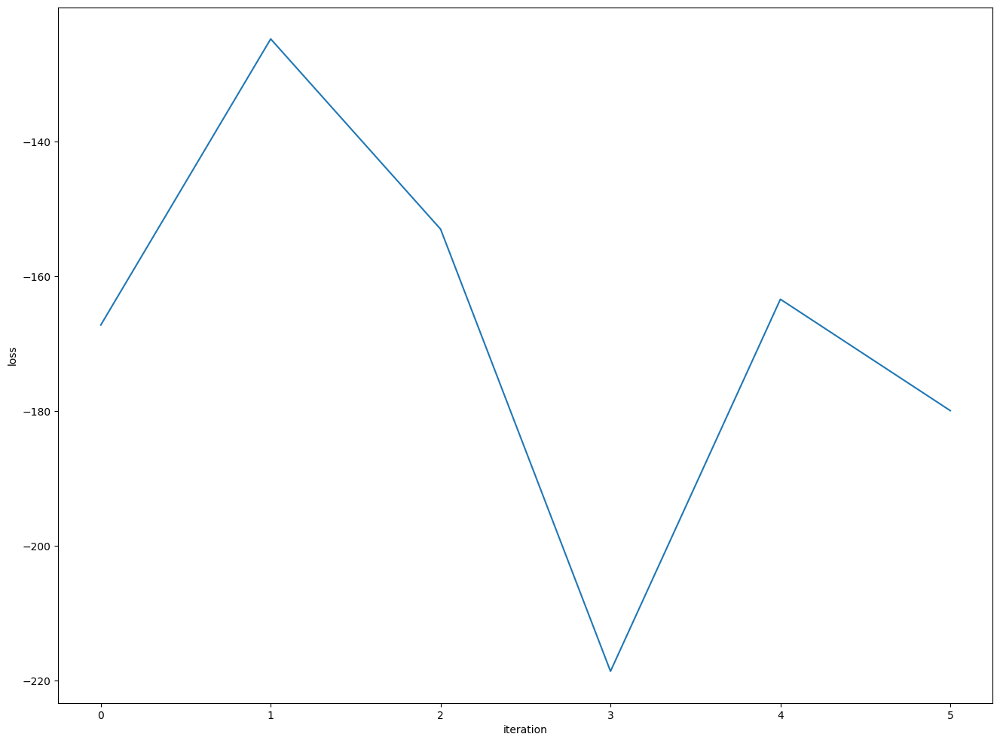

In [69]:
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.png")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.eps")
plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

Text(0, 0.5, 'loss')

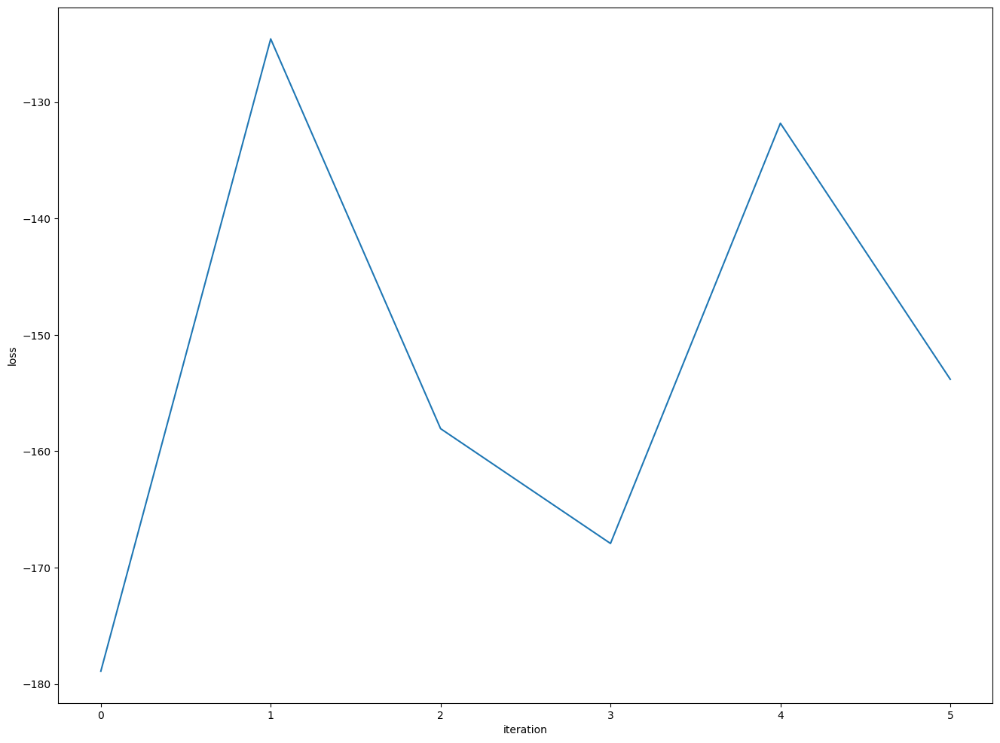

In [70]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")